In [1]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
import matplotlib as mpl
import paste
import scipy
import anndata
import os
import umap
from sklearn.decomposition import PCA
import scanpy as sc
import warnings
import json
from PIL import Image
import torch
import seaborn
from torch import nn
import torch.nn.functional as F
import cv2
from tqdm import tqdm
from matplotlib.colors import rgb2hex
import random

2024-08-21 11:25:48.753384: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-21 11:25:50.557385: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-21 11:25:50.557477: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/ap

In [2]:
def get_library_id(adata):
    assert 'spatial' in adata.uns, "spatial not present in adata.uns"
    library_ids = adata.uns['spatial'].keys()
    try:
        library_id = list(library_ids)[0]
        return library_id
    except IndexError:
        logger.error('No library_id found in adata')

def get_scalefactors(adata, library_id=None):
    if library_id is None:
        library_id = get_library_id(adata)
    try:
        scalef = adata.uns['spatial'][library_id]['scalefactors']
        return scalef
    except IndexError:
        logger.error('scalefactors not found in adata')

def get_spot_diameter_in_pixels(adata, library_id=None):
    scalef = get_scalefactors(adata, library_id=library_id) 
    try:
        spot_diameter = scalef['spot_diameter_fullres']
        return spot_diameter    
    except TypeError:
        pass
    except KeyError:
        logger.error('spot_diameter_fullres not found in adata')

In [37]:
def segment_patches(ad):
    library_id = get_library_id(ad)
    scalef = ad.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef']
    hires_img = ad.uns['spatial'][library_id]['images']['hires']
    if hires_img.max()<1.1:
        hires_img = hires_img*255
    
    spot_dia_px = round(get_spot_diameter_in_pixels(ad)*scalef)
    print(scalef)
    print(spot_dia_px)
    height, width = spot_dia_px, spot_dia_px  # maximum height and width without overlapping among patches
    yrange, xrange = hires_img.shape[:2]
    
    for spot_idx in tqdm(ad.obs.index):
    
        ycenter, xcenter = ad.obs.loc[spot_idx, ["pixel_x","pixel_y"]].astype(float)*scalef
        x1 = round(xcenter - width / 2)
        y1 = round(ycenter - height / 2)
        x2 = x1 + width
        y2 = y1 + height
    
        if x1 < 0 or y1 < 0 or x2 > xrange or y2 > yrange:
            print(f'Patch {spot_idx} is out of range.')
            continue
    
        patch_img = Image.fromarray(hires_img[y1:y2, x1:x2].astype(np.uint8))
        patch_name = '_'.join([f'{spot_idx}_hires.png'])
        patch_path = os.path.join(PATCH_DIR, patch_name)
        patch_img.save(patch_path)

In [38]:
def generate_training_df(ad):
    ad = ad[:,~ad.var.index.str.contains('.', regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-', regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X.todense(), index=ad.obs.index, columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)
    top_k_genes_str['img_path'] = PATCH_DIR+ad.obs.index+'_hires.png'
    top_k_genes_str.to_csv(data_path+str(sample_name)+'_training_df.csv')

In [25]:
def plt_pie_chart(data, coordinates, colors):
    pie_size = 0.012
    fig = plt.figure(figsize=(8, 8))
    for i in tqdm(range(data.shape[0])):
        sizes = data[i]
        coord = coordinates[i]
        subax = fig.add_axes([coord[0], coord[1], pie_size, pie_size])
        subax.pie(sizes, colors=colors)
        subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.
    plt.show()

In [39]:
def get_pca_by_fit(tar_features, src_features):
    pca_fit_tar = pca.fit(tar_features.T)
    pca_tar = pca_fit_tar.transform(tar_features.T)
    pca_src = pca_fit_tar.transform(src_features.T)
    pca_comb_features = np.concatenate((pca_tar, pca_src))
    pca_comb_features_batch = np.array([0]*len(pca_tar) + [1]*len(pca_src))

    return pca_comb_features, pca_comb_features_batch

In [32]:
# cmap = plt.colormaps["Dark2"]
cmap = plt.colormaps["Set2"]

In [6]:
fit = umap.UMAP(n_components=3)

In [7]:
pca = PCA(n_components=3)

In [ ]:
k=50
house_keeping_genes = pd.read_csv("/condo/wanglab/shared/wxc/clip/data/human/ST_data/housekeeping_genes.csv", index_col = 0)
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/HM_data/image/patch/"

In [8]:
from open_clip import create_model_from_pretrained, get_tokenizer
import open_clip

In [9]:
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/image/patches/"
DEVICE = "cuda"

In [8]:
data_path = '/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC/'

In [9]:
sample_name = 'TNBC_processed_adata_raw'

# Xenium Component

In [10]:
ad_vis = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_vis

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [177]:
ad_vis[ad_vis.obs['cell_num']>3]

View of AnnData object with n_obs × n_vars = 2790 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial', 'pca', 'neighbors', 'leiden'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/plotting/_utils.py:431: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


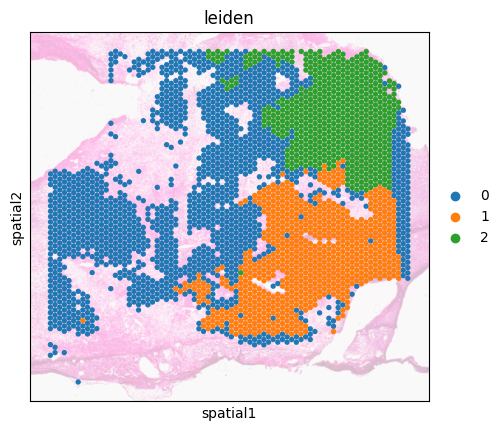

In [176]:
sc.pl.spatial(ad_vis[ad_vis.obs['cell_num']>3],color='leiden',alpha_img=0.3,spot_size=400)

In [156]:
ad_vis

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden', 'n_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial', 'pca', 'neighbors', 'leiden'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [50]:
sc.pp.pca(ad_vis)
sc.pp.neighbors(ad_vis)

In [138]:
sc.tl.leiden(ad_vis, resolution=0.1)

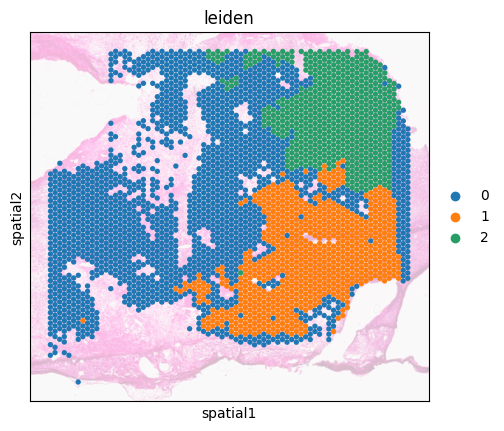

In [139]:
sc.pl.spatial(ad_vis,color='leiden',alpha_img=0.3,spot_size=400)

In [11]:
ad_xen_sp = sc.read_h5ad('/condo/wanglab/shared/wxc/clip/data/human/HM_data/TNBC_Xenium_spot_anno.h5ad')
ad_xen_sp

AnnData object with n_obs × n_vars = 54102 × 280
    obs: 'in_tissue', 'spot', 'n_counts', 'leiden', 'louvain', 'cell_type_lv', 'cell_type'
    var: 'gene_ids', 'feature_types'
    uns: 'cell_type_colors', 'dendrogram_louvain', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [13]:
ad_xen_sp = ad_xen_sp[ad_xen_sp.obs['spot'].isin(ad_vis.obs.index)]
ad_xen_sp

View of AnnData object with n_obs × n_vars = 50592 × 280
    obs: 'in_tissue', 'spot', 'n_counts', 'leiden', 'louvain', 'cell_type_lv', 'cell_type'
    var: 'gene_ids', 'feature_types'
    uns: 'cell_type_colors', 'dendrogram_louvain', 'leiden', 'leiden_colors', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [14]:
ad_xen_sp.obs['cell_type'].value_counts()/ad_xen_sp.obs['cell_type'].value_counts().sum()

cell_type
Epithelial    0.867825
Stroma        0.075249
Immune        0.056926
Name: count, dtype: float64

In [18]:
deconv_df = ad_xen_sp.obs.pivot_table(index='spot', columns='cell_type', aggfunc='size').reindex(ad_vis.obs.index).T
deconv_df = deconv_df/deconv_df.sum(axis=0)
deconv_df

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
cell_type,,,,,,,,,,,,,,,,,,,,,
Epithelial,1.0,0.916667,0.916667,0.769231,1.0,0.428571,0.8125,0.5,0.8,1.0,...,1.0,1.0,1.0,1.0,0.733333,1.0,1.0,0.793103,1.0,0.8
Immune,0.0,0.083333,0.083333,0.230769,0.0,0.571429,0.1875,0.5,0.1,0.0,...,0.0,0.0,0.0,0.0,0.066667,0.0,0.0,0.000000,0.0,0.2
Stroma,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0000,0.0,0.1,0.0,...,0.0,0.0,0.0,0.0,0.200000,0.0,0.0,0.206897,0.0,0.0


100%|██████████| 3104/3104 [00:53<00:00, 57.50it/s]


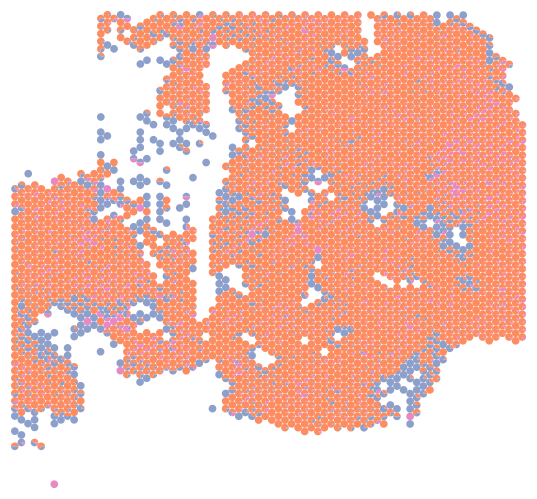

In [33]:
data = np.array(deconv_df.T)
coordinates = np.array([ad_vis.obsm['spatial'][:, 0], -ad_vis.obsm['spatial'][:, 1]]).T/ad_vis.obsm['spatial'].max()
colors = cmap([1, 2, 3])
plt_pie_chart(data, coordinates, colors)

# Tengram Deconv

In [27]:
def generate_features(ad, case_name):
    top_k_genes_str= pd.read_csv(data_path+str(sample_name)+'_training_df.csv', index_col=0)
    text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
    text_features = pd.DataFrame()
    image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
    image_features = pd.DataFrame()
    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx]['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]

        image = Image.open(os.path.join(PATCH_DIR, patch_idx+'_hires.png'))
        image_input = torch.stack([preprocess(image)]).to(DEVICE)
        with torch.no_grad():
            image_features[patch_idx] = model.encode_image(image_input).cpu().detach().numpy()[0]
    
    image_features.to_csv(image_feature_path)
    text_features.to_csv(text_feature_path)

## Before Finetune

In [144]:
case_name = '_training20'

### Generate embeddings

In [162]:
ad_vis_raw = sc.read_h5ad(data_path+sample_name+'.h5ad')

In [163]:
ad_vis_raw

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [43]:
segment_patches(ad_vis_raw)

0.042668488
12


100%|██████████| 4168/4168 [00:33<00:00, 123.24it/s]


In [26]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_03_25-19_46_42-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_20.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [38]:
generate_training_df(ad_vis_raw)

In [44]:
generate_features(ad_vis_raw, case_name)

100%|██████████| 4168/4168 [02:05<00:00, 33.08it/s]


### QC

In [145]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_vis.obs.index]
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_vis.obs.index]

In [40]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(text_features, image_features)

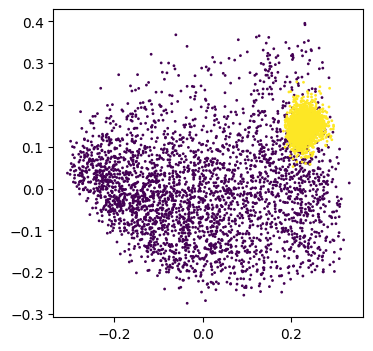

In [41]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [43]:
pca_txt_fit = pca.fit(text_features.T)
pca_txt = pca_txt_fit.transform(text_features.T)
pca_img = pca_txt_fit.transform(image_features.T)

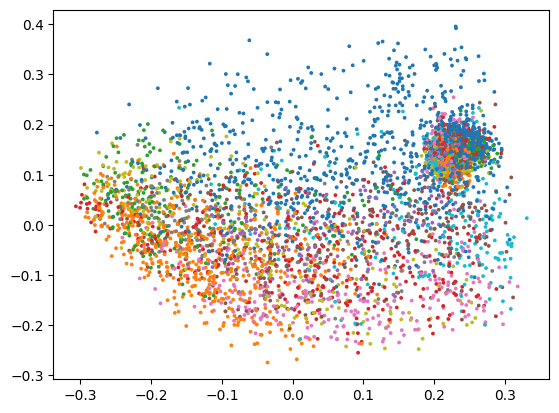

In [52]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad_vis.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad_vis.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [54]:
txt_ad = anndata.AnnData(text_features.T)
txt_ad.uns['spatial']=ad_vis.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_vis.obsm['spatial'].copy()
txt_ad

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 3104 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [55]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [102]:
# sc.tl.leiden(txt_ad)
sc.tl.leiden(txt_ad,resolution=0.2)

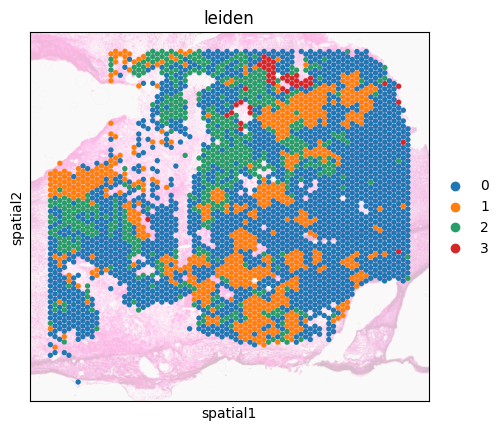

In [103]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [146]:
img_ad = anndata.AnnData(image_features[ad_vis.obs.index].T)
img_ad.uns['spatial']=ad_vis.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_vis.obsm['spatial'].copy()

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [147]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [150]:
sc.tl.leiden(img_ad,resolution=0.35)

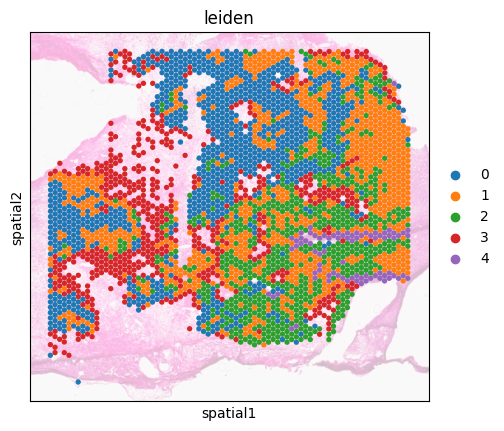

In [151]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## Generate df for finetune

In [88]:
training_df = pd.read_csv(data_path+str(sample_name)+'_training_df.csv',index_col=0)
training_df

,label,img_path
TNBC_processed_adata_AACACGTGCATCGCAC-1,ECRG4 LMAN2 MGAT4B MDFI EHF CRYAB CHMP2A CLSTN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACACTTGGCAAGGAA-1,CITED4 S100A1 MFGE8 COL2A1 IER2 NUCB1 SOX4 APP...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGAAGAGCATAG-1,GAK CDK11B MED8 POLR3C BOLA1 S100A1 ARHGEF2 RN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGATTCATAGTT-1,CITED4 KRT14 KRT15 S100A1 PTMS MSLN S100A6 LMN...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_AACAGGCCAACGATTA-1,ECRG4 CITED4 SCGB3A1 KRT19 S100A1 CHPF ITM2C C...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,S100A1 KRT15 ECRG4 SYT8 COL9A3 COL11A2 COL2A1 ...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,KRT15 S100A1 ECRG4 SCGB3A1 SYT8 CITED4 MSLN KR...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,MFGE8 CRABP2 PTMS LMNA CRABP1 TRIM29 DDR1 MIA ...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...
TNBC_processed_adata_TGTTGGATGGACTTCT-1,KRT15 S100A1 BGN COL2A1 EPHB3 CITED4 MSLN SOX4...,/condo/wanglab/shared/wxc/clip/data/human/HM_d...


In [89]:
ad = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')

In [90]:
ad

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [91]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [92]:
sc.tl.umap(ad)

In [93]:
sc.tl.leiden(ad, resolution=0.247)

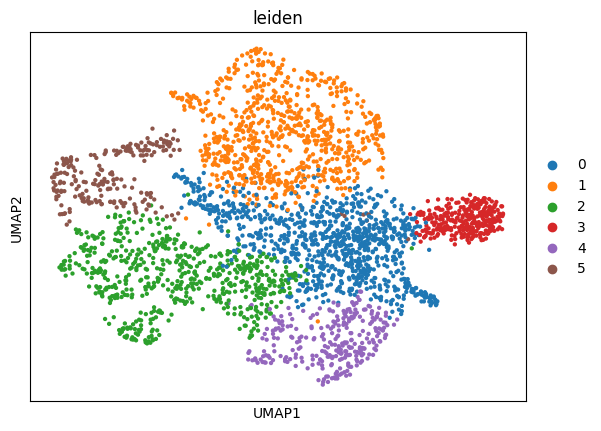

In [94]:
sc.pl.umap(ad, color='leiden')

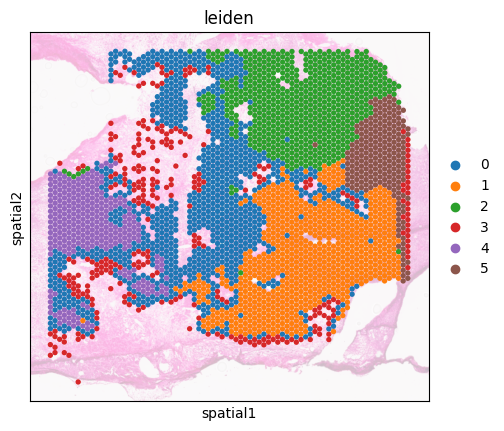

In [95]:
sc.pl.spatial(ad, color='leiden',alpha_img=0.3,spot_size=400)

In [96]:
row_num = ad.obs['array_row'].max()-ad.obs['array_row'].min()
col_num = ad.obs['array_col'].max()-ad.obs['array_col'].min()

### Cut Right Bottom

In [98]:
cut_case = '_filter100g_rb'

In [99]:
ad_sub = ad[(ad.obs['array_col']<(col_num/2))&(ad.obs['array_row']<(row_num/2)),:]

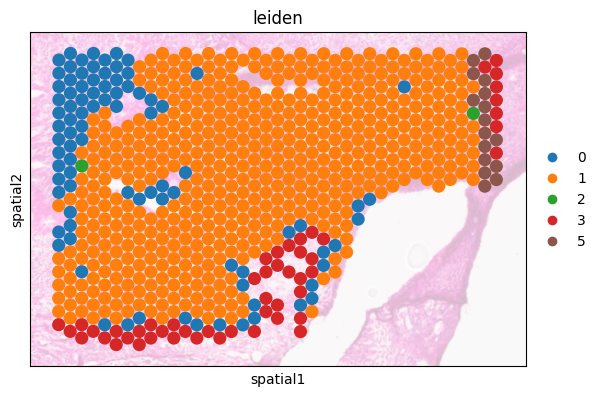

In [100]:
sc.pl.spatial(ad_sub, color='leiden',alpha_img=0.3,spot_size=400)

In [25]:
training_df.loc[ad_sub.obs.index].to_csv(data_path+str(sample_name)+'_training_df'+str(cut_case)+'.csv')

### Cut Left Bottom

In [101]:
cut_case = '_filter100g_lb'

In [104]:
ad_sub = ad[(ad.obs['array_col']<(col_num/2))&(ad.obs['array_row']>(row_num/2)),:]

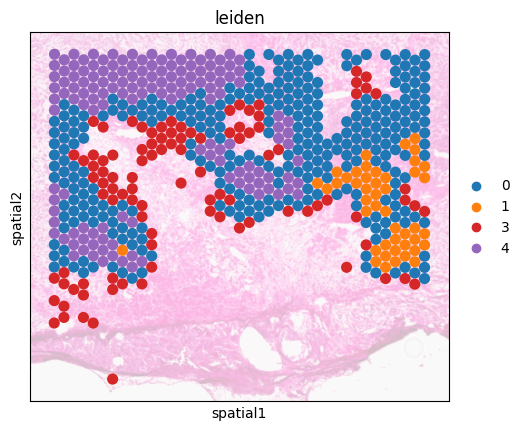

In [105]:
sc.pl.spatial(ad_sub, color='leiden',alpha_img=0.3,spot_size=400)

In [106]:
training_df.loc[ad_sub.obs.index].to_csv(data_path+str(sample_name)+'_training_df'+str(cut_case)+'.csv')

### Cut Left Top

In [107]:
cut_case = '_filter100g_lt'

In [108]:
ad_sub = ad[(ad.obs['array_col']>(col_num/2))&(ad.obs['array_row']>(row_num/2)),:]

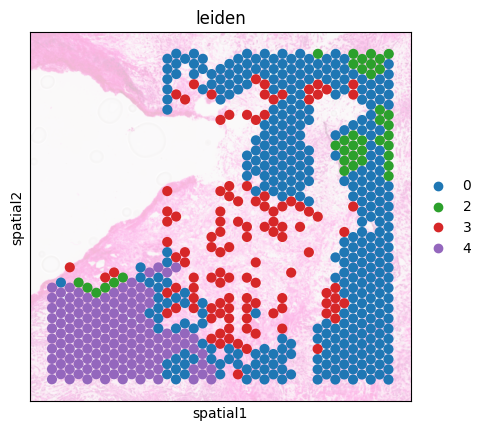

In [109]:
sc.pl.spatial(ad_sub, color='leiden',alpha_img=0.3,spot_size=400)

In [110]:
training_df.loc[ad_sub.obs.index].to_csv(data_path+str(sample_name)+'_training_df'+str(cut_case)+'.csv')

### Cut Right Top

In [111]:
cut_case = '_filter100g_rt'

In [112]:
ad_sub = ad[(ad.obs['array_col']>(col_num/2))&(ad.obs['array_row']<(row_num/2)),:]

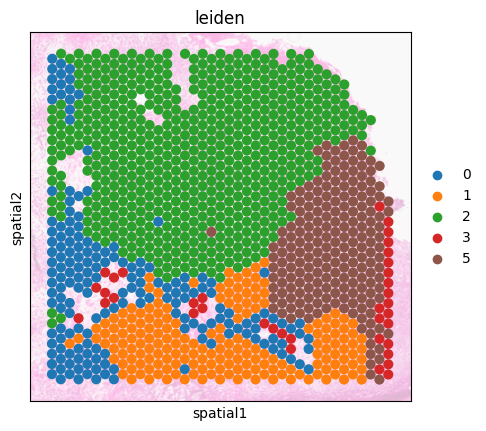

In [113]:
sc.pl.spatial(ad_sub, color='leiden',alpha_img=0.3,spot_size=400)

In [114]:
training_df.loc[ad_sub.obs.index].to_csv(data_path+str(sample_name)+'_training_df'+str(cut_case)+'.csv')

## After Finetune all

In [54]:
case_name = '_finetune10'

In [55]:
ad = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')

In [56]:
ad

AnnData object with n_obs × n_vars = 3280 × 14263
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatial'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

### Generate Finetune Features

In [57]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_09-21_16_21-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [ ]:
generate_features(ad, case_name)

### QC

In [59]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]

In [60]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [61]:
comb_features = pd.concat([image_features,text_features],axis=1)

In [62]:
pca_comb_features = pca.fit_transform(comb_features.T)

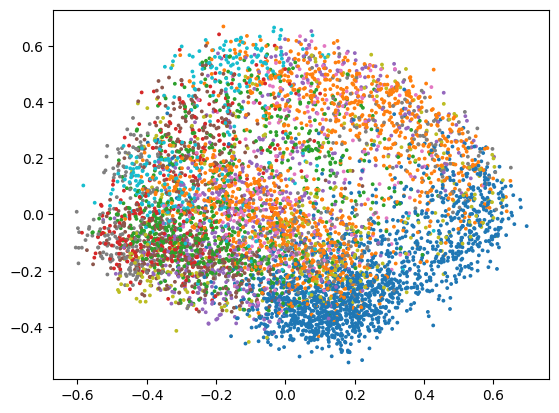

In [63]:
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pd.concat([ad.obs['leiden'].astype('category').cat.codes,ad.obs['leiden'].astype('category').cat.codes]), s=3,cmap='tab10')

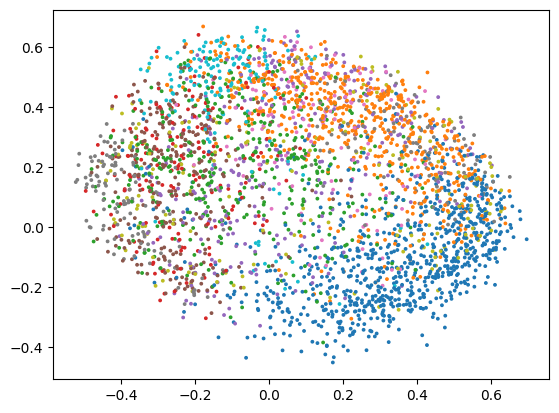

In [64]:
plt.scatter(pca_comb_features[:len(image_features.T),0], pca_comb_features[:len(image_features.T),1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

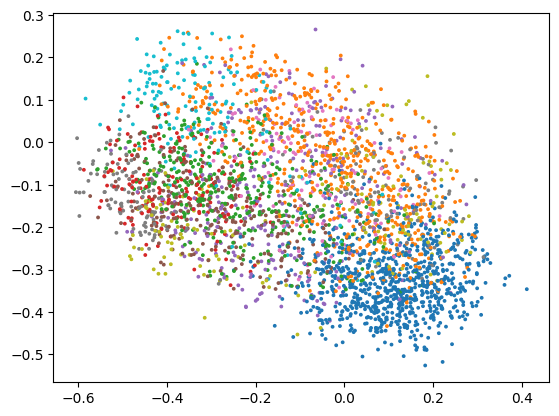

In [65]:
plt.scatter(pca_comb_features[len(image_features.T):,0], pca_comb_features[len(image_features.T):,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [66]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [67]:
len(pca_hex_comb)

6560

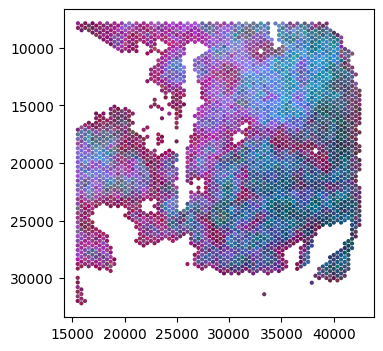

In [68]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[len(image_features.T):])
plt.gca().invert_yaxis()

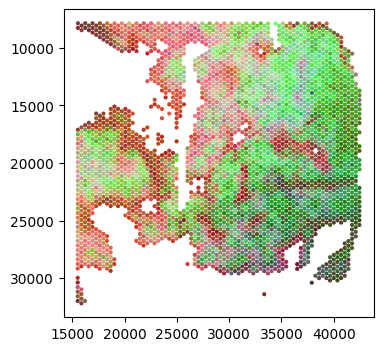

In [69]:
plt.figure(figsize=(4,4))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=4, c=pca_hex_comb[:len(image_features.T)])
plt.gca().invert_yaxis()

In [70]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

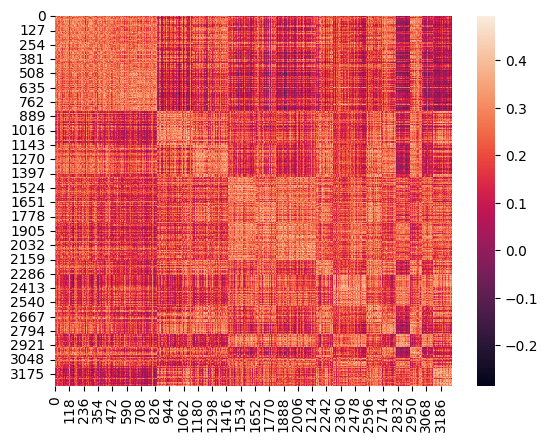

In [71]:
sns.heatmap(dot_simi)

In [72]:
txt_ad = anndata.AnnData(text_features.T)

In [73]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [74]:
txt_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [75]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [76]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

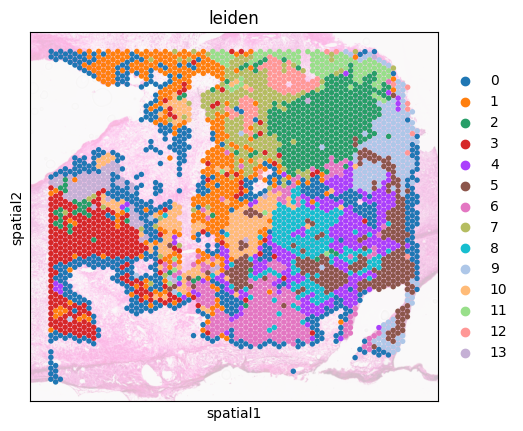

In [77]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [49]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)

In [50]:
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [51]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [52]:
sc.tl.leiden(img_ad)

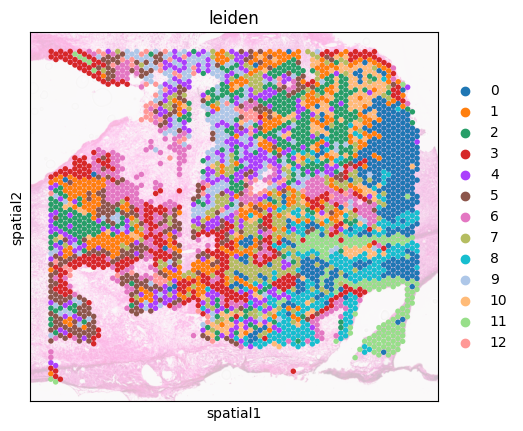

In [53]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## After Finetune rb

In [13]:
case_name = '_finetune10_filter100g_rb'

In [14]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [27]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [28]:
sc.tl.leiden(ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

### Generate Finetune Features

In [15]:
model_dir = "2024_08_16-17_35_33-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [16]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [17]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:09<00:00, 32.15it/s]


### QC

In [18]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]

In [19]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [29]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

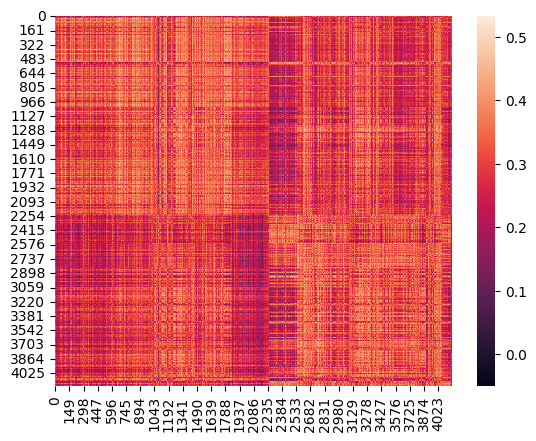

In [30]:
sns.heatmap(dot_simi)

In [31]:
pca_txt_fit = pca.fit(text_features.T)

In [32]:
pca_txt = pca_txt_fit.transform(text_features.T)

In [33]:
pca_img = pca_txt_fit.transform(image_features.T)

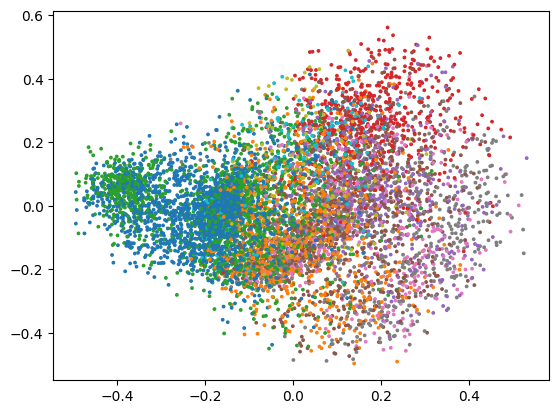

In [34]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [35]:
txt_ad = anndata.AnnData(text_features.T)

In [36]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [37]:
txt_ad

AnnData object with n_obs × n_vars = 4168 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [38]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [39]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

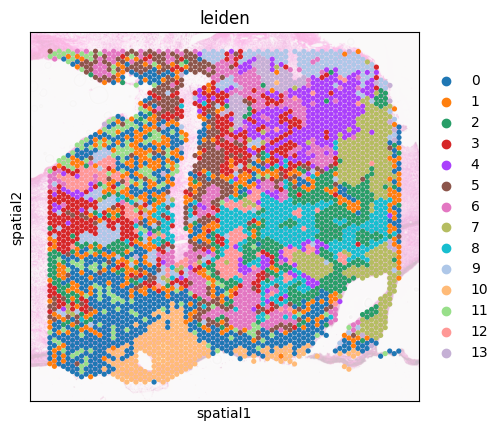

In [40]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [41]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)

In [42]:
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [43]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [44]:
sc.tl.leiden(img_ad)

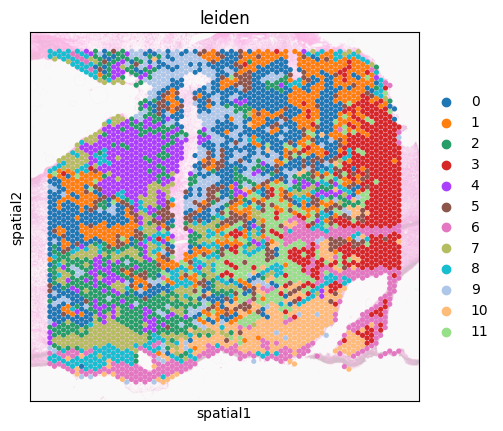

In [45]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## After Finetune rt

In [10]:
case_name = '_finetune10_filter100g_rt'

In [11]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [12]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [13]:
sc.tl.leiden(ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

### Generate Finetune Features

In [14]:
model_dir = "2024_08_19-10_07_57-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [15]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [18]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:29<00:00, 27.86it/s]


### QC

In [21]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [22]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

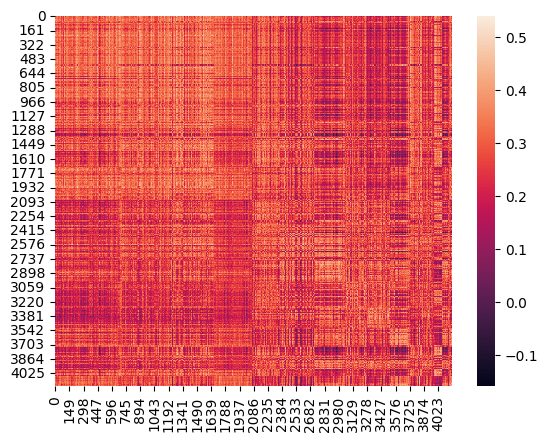

In [23]:
sns.heatmap(dot_simi)

In [24]:
pca_txt_fit = pca.fit(text_features.T)
pca_txt = pca_txt_fit.transform(text_features.T)
pca_img = pca_txt_fit.transform(image_features.T)

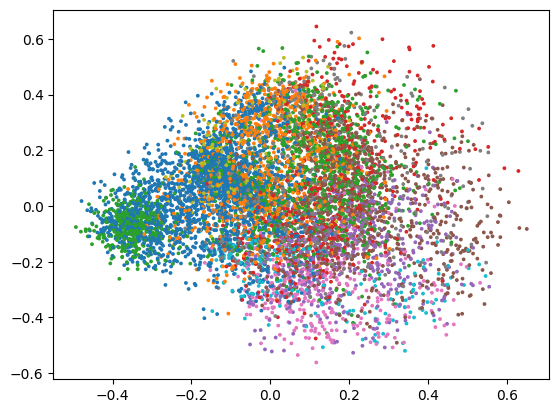

In [25]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [26]:
txt_ad = anndata.AnnData(text_features.T)
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 4168 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [27]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [28]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

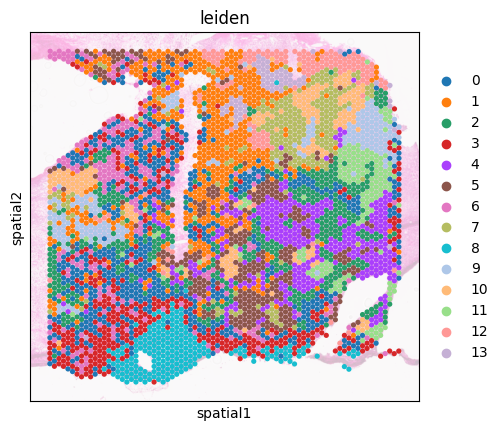

In [29]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [30]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [31]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [32]:
sc.tl.leiden(img_ad)

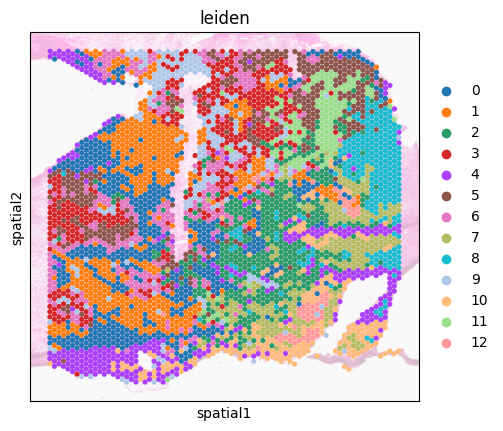

In [33]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## After Finetune lb

In [125]:
case_name = '_finetune10_filter100g_lb'

In [126]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [127]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [128]:
sc.tl.leiden(ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

### Generate Finetune Features

In [129]:
model_dir = "2024_08_19-10_22_37-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [130]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_19-10_22_37-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [131]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:14<00:00, 30.92it/s]


### QC

In [133]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad.obs.index]
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad.obs.index]

In [134]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

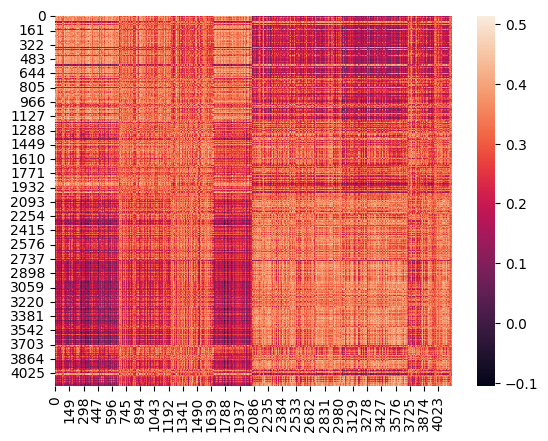

In [135]:
sns.heatmap(dot_simi)

In [136]:
pca_txt_fit = pca.fit(text_features.T)
pca_txt = pca_txt_fit.transform(text_features.T)
pca_img = pca_txt_fit.transform(image_features.T)

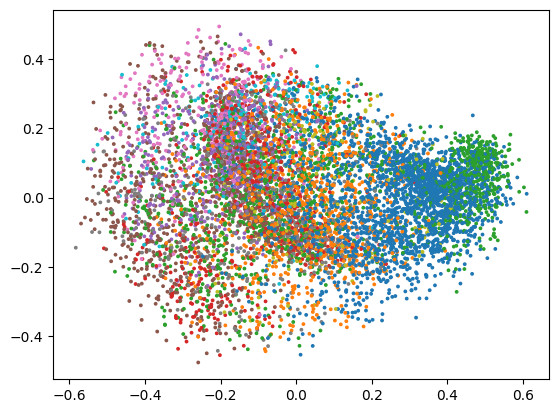

In [137]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [139]:
txt_ad = anndata.AnnData(text_features.T)
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 4168 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [140]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [141]:
sc.tl.leiden(txt_ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

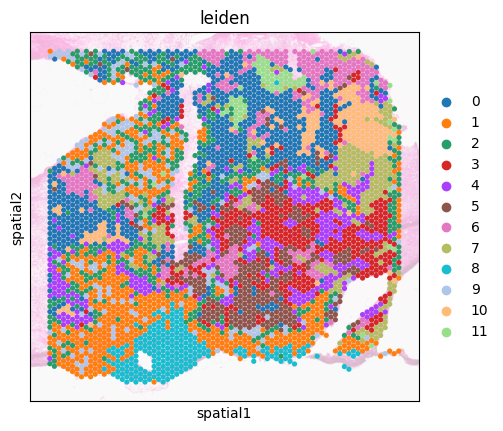

In [142]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [143]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [144]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [145]:
sc.tl.leiden(img_ad)

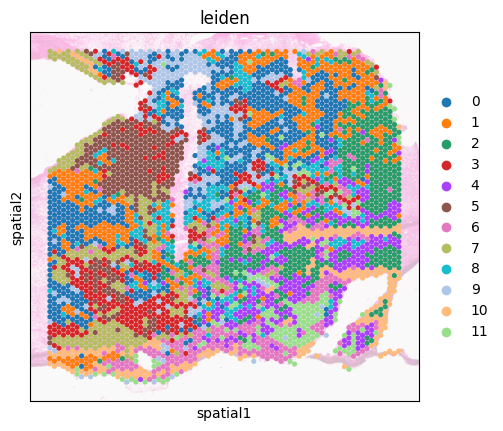

In [146]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

## After Finetune lt

In [110]:
case_name = '_finetune10_filter100g_lt'

In [111]:
ad = sc.read_h5ad(data_path+sample_name+'.h5ad')
ad

AnnData object with n_obs × n_vars = 4168 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [112]:
sc.pp.pca(ad)
sc.pp.neighbors(ad)

In [113]:
sc.tl.leiden(ad)
# sc.tl.leiden(txt_ad,resolution=0.6)

### Generate Finetune Features

In [77]:
model_dir = "2024_08_19-10_16_08-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [78]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_19-10_16_08-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [79]:
generate_features(ad, case_name)

100%|██████████| 4168/4168 [02:15<00:00, 30.83it/s]


### QC

In [114]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_vis.obs.index]
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_vis.obs.index]

In [117]:
dot_simi = np.dot(np.array(image_features[ad_vis.obs.sort_values('leiden').index]).T, np.array(text_features[ad_vis.obs.sort_values('leiden').index]))

<Axes: >

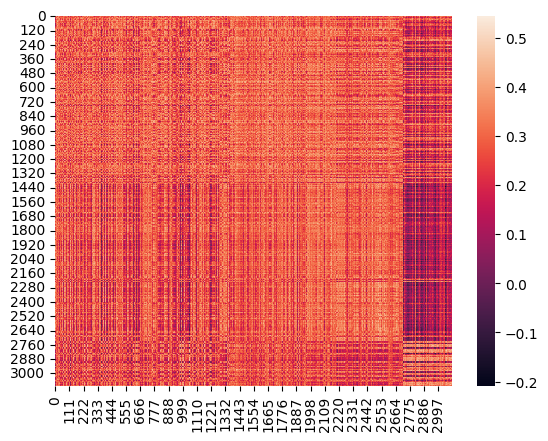

In [118]:
sns.heatmap(dot_simi)

In [119]:
pca_txt_fit = pca.fit(text_features.T)
pca_txt = pca_txt_fit.transform(text_features.T)
pca_img = pca_txt_fit.transform(image_features.T)

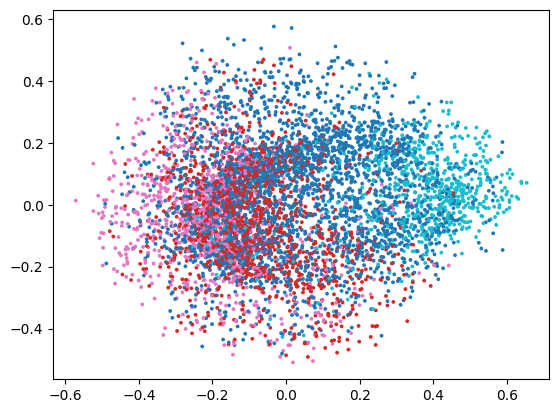

In [120]:
plt.scatter(pca_img[:,0], pca_img[:,1],c=ad_vis.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')
plt.scatter(pca_txt[:,0], pca_txt[:,1],c=ad_vis.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [121]:
txt_ad = anndata.AnnData(text_features.T)
txt_ad.uns['spatial']=ad_vis.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_vis.obsm['spatial'].copy()
txt_ad

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 3104 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [122]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [136]:
# sc.tl.leiden(txt_ad)
sc.tl.leiden(txt_ad,resolution=0.3)

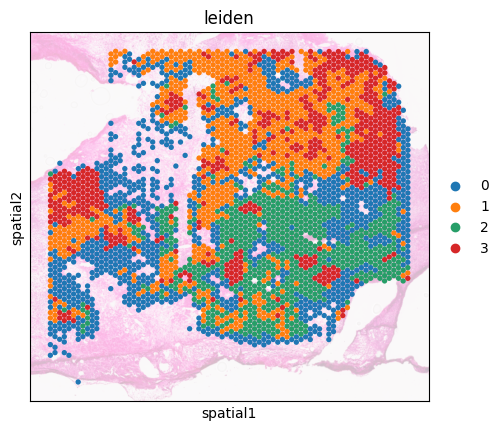

In [137]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

In [128]:
img_ad = anndata.AnnData(image_features[ad_vis.obs.index].T)
img_ad.uns['spatial']=ad_vis.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_vis.obsm['spatial'].copy()

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [129]:
sc.pp.pca(img_ad)
sc.pp.neighbors(img_ad)

In [142]:
sc.tl.leiden(img_ad,resolution=0.35)

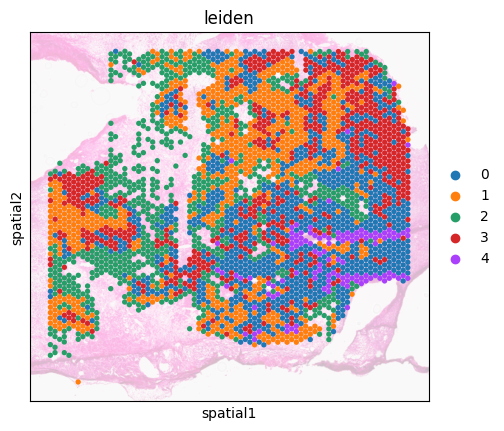

In [143]:
sc.pl.spatial(img_ad,color='leiden',alpha_img=0.3,spot_size=400)

#### Cut (old)

In [195]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_09-21_33_33-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [284]:
case_name = '_cut_finetune10'

In [285]:
ad = sc.read_h5ad(data_path+sample_name+'_cut.h5ad')

In [286]:
# generate_finetune_text_features(ad, case_name)

In [287]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)

In [288]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)

In [205]:
umap_image_features = fit.fit_transform(image_features.T)
umap_text_features = fit.fit_transform(text_features.T)

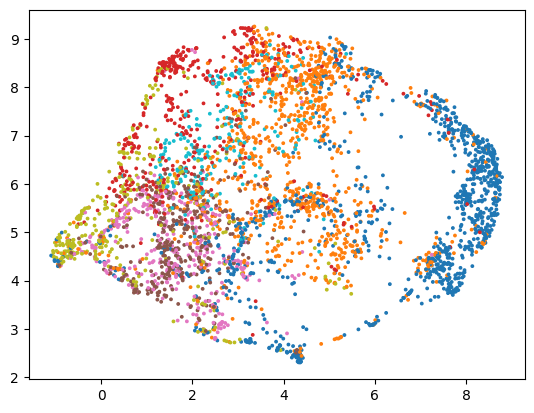

In [206]:
plt.scatter(umap_image_features[:,0],umap_image_features[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

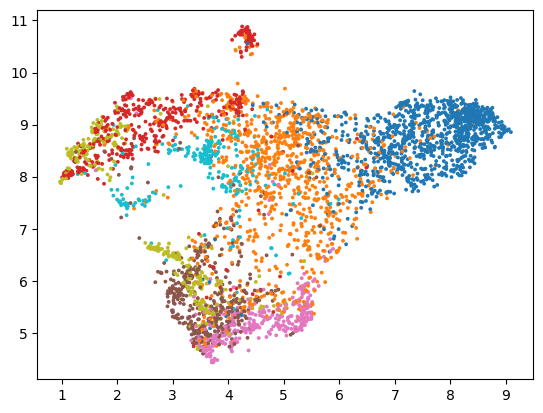

In [207]:
plt.scatter(umap_text_features[:,0],umap_text_features[:,1],c=ad.obs['leiden'].astype('category').cat.codes, s=3,cmap='tab10')

In [208]:
dot_simi = np.dot(np.array(image_features[ad.obs.sort_values('leiden').index]).T, np.array(text_features[ad.obs.sort_values('leiden').index]))

<Axes: >

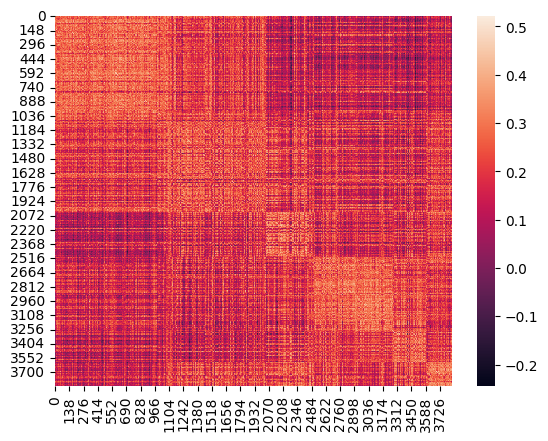

In [209]:
sns.heatmap(dot_simi)

In [210]:
umap_rgb_image = (umap_image_features-umap_image_features.min(axis=0))/(umap_image_features.max(axis=0)-umap_image_features.min(axis=0))
umap_hex_image = [ rgb2hex(umap_rgb_image[i,:]) for i in range(umap_rgb_image.shape[0]) ]

In [211]:
umap_rgb_text = (umap_text_features-umap_text_features.min(axis=0))/(umap_text_features.max(axis=0)-umap_text_features.min(axis=0))
umap_hex_text = [ rgb2hex(umap_rgb_text[i,:]) for i in range(umap_rgb_text.shape[0]) ]

(45000.0, 0.0)

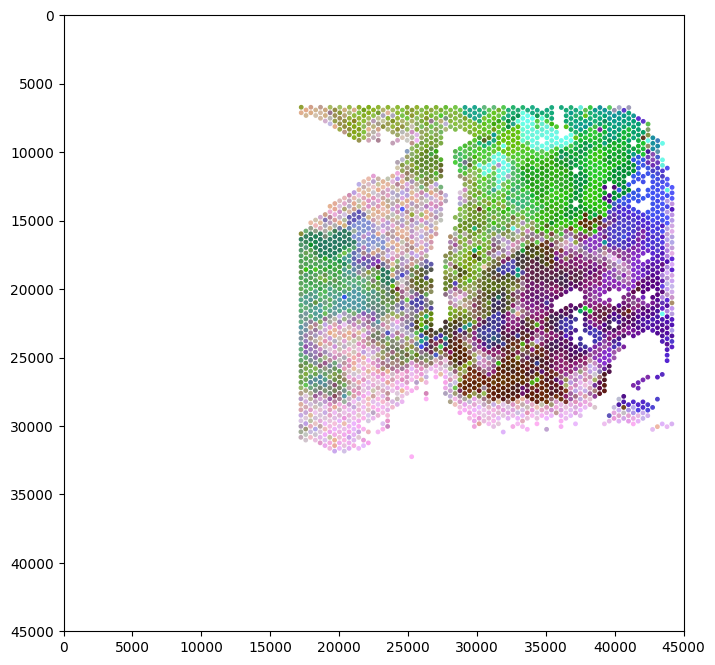

In [212]:
plt.figure(figsize=(8,8))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=6, c=umap_hex_text)
plt.gca().invert_yaxis()
plt.xlim((0,45000))
plt.ylim((45000,0))

(45000.0, 0.0)

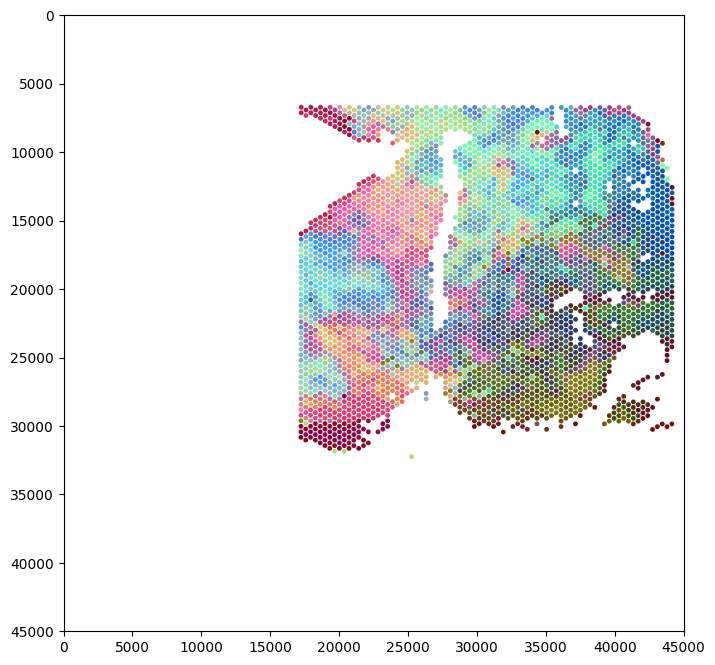

In [213]:
plt.figure(figsize=(8,8))
plt.scatter(ad.obsm['spatial'][:,0], ad.obsm['spatial'][:,1], marker='o', s=6, c=umap_hex_image)
plt.gca().invert_yaxis()
plt.xlim((0,45000))
plt.ylim((45000,0))

In [290]:
txt_ad = anndata.AnnData(text_features.T)

In [291]:
txt_ad.uns['spatial']=ad.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad.obsm['spatial'].copy()

In [292]:
txt_ad

AnnData object with n_obs × n_vars = 3842 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [293]:
sc.pp.pca(txt_ad)
sc.pp.neighbors(txt_ad)

In [294]:
sc.tl.leiden(txt_ad,resolution=0.47)

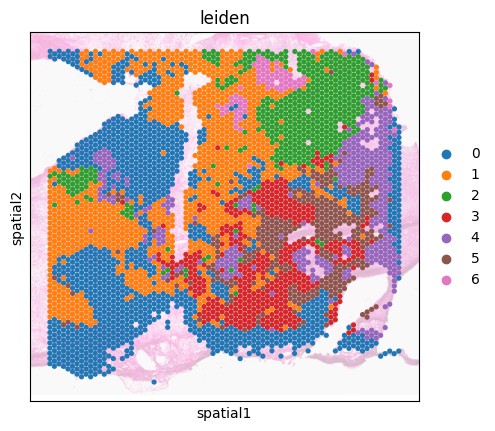

In [295]:
sc.pl.spatial(txt_ad,color='leiden',alpha_img=0.3,spot_size=400)

## Read scRNA data

In [46]:
sc_data_path = '/condo/wanglab/shared/DATA_ARCHIVE/data/2.scRNA_data/TNBC_SC/processed_data/TNBC_SC.h5ad'

In [47]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [48]:
sc_data.obs

,cell_type
PT089_P1_A01,epithelial
PT089_P1_A02,epithelial
PT089_P1_A03,epithelial
PT089_P1_A04,macrophage
PT089_P1_A05,macrophage
...,...
PT039_P10_H07_S283,epithelial
PT039_P10_H08_S284,macrophage
PT039_P10_H09_S285,epithelial
PT039_P10_H11_S287,epithelial


#### sc Plot

In [ ]:
# sc.pp.filter_cells(sc_data, min_genes=100)
# sc.pp.filter_genes(sc_data, min_cells=3)

In [ ]:
# sc_data.layers["counts"] = sc_data.X.copy()
# sc.pp.normalize_total(sc_data)
# sc.pp.log1p(sc_data)

In [95]:
sc.tl.pca(sc_data)
sc.pp.neighbors(sc_data)
sc.tl.umap(sc_data)

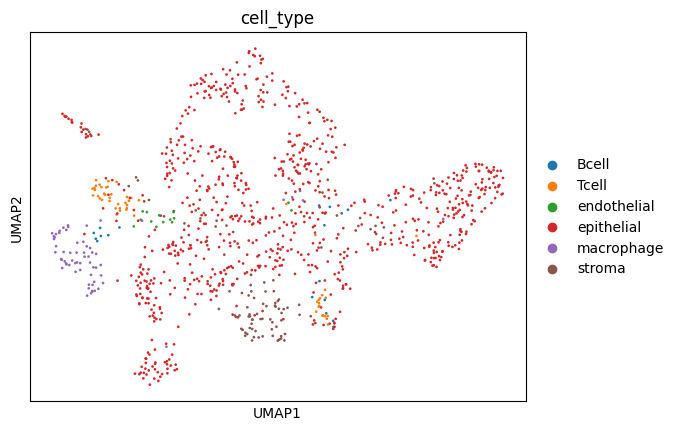

In [96]:
sc.pl.umap(sc_data,color='cell_type',size=15)

In [97]:
sc.tl.rank_genes_groups(sc_data, groupby="cell_type", use_raw=False)

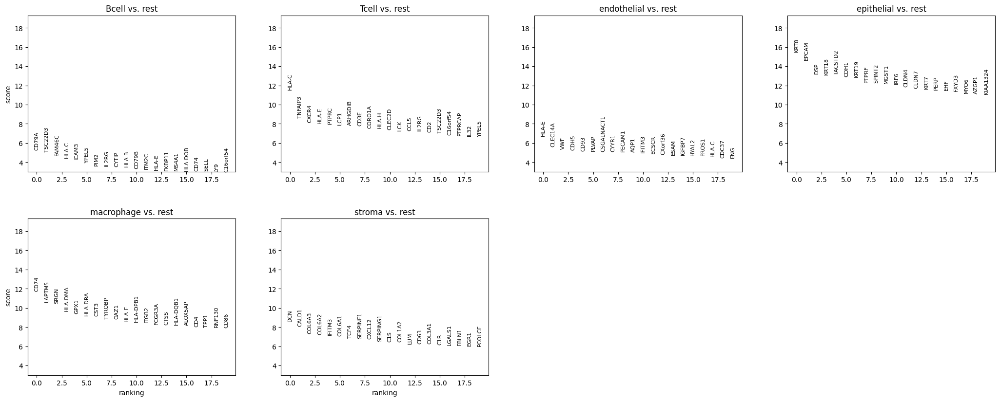

In [98]:
sc.pl.rank_genes_groups(sc_data)

## Generate feature of sc data

In [44]:
def generate_sc_feartures(ad, case_name):
    ad = ad[:,~ad.var.index.str.contains('.', regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-', regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X, index=ad.obs.index, columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)

    text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
    text_features = pd.DataFrame()

    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx]['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]
            
    text_features.to_csv(text_feature_path)

In [147]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [ ]:
# case_name = '_training20'
# model_dir = "2024_03_25-19_46_42-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
# epoch_n = "epoch_20.pt"

In [16]:
# case_name = '_fintune10'
# model_dir = "2024_08_09-21_16_21-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
# epoch_n = "epoch_10.pt"

In [51]:
case_name = '_finetune10_filter100g_rb'
model_dir = "2024_08_16-17_35_33-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [52]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [53]:
generate_sc_feartures(sc_data, case_name)

100%|██████████| 1112/1112 [00:05<00:00, 187.34it/s]


In [45]:
case_name = '_finetune10_filter100g_rt'
model_dir = "2024_08_19-10_07_57-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [46]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_19-10_07_57-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [47]:
generate_sc_feartures(sc_data, case_name)

100%|██████████| 1062/1062 [00:05<00:00, 201.59it/s]


In [93]:
case_name = '_finetune10_filter100g_lt'
model_dir = "2024_08_19-10_16_08-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [94]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_19-10_16_08-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [96]:
generate_sc_feartures(sc_data, case_name)

100%|██████████| 1112/1112 [00:05<00:00, 201.96it/s]


In [148]:
case_name = '_finetune10_filter100g_lb'
model_dir = "2024_08_19-10_22_37-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"

In [149]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

INFO:root:Loaded coca_ViT-L-14 model config.
INFO:root:Loading pretrained coca_ViT-L-14 weights (/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs/2024_08_19-10_22_37-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp/checkpoints/epoch_10.pt).


In [150]:
generate_sc_feartures(sc_data, case_name)

100%|██████████| 1112/1112 [00:05<00:00, 197.57it/s]


# Deconv

In [34]:
import tangram as tg

In [35]:
sc_data_path = '/condo/wanglab/shared/DATA_ARCHIVE/data/2.scRNA_data/TNBC_SC/processed_data/TNBC_SC.h5ad'

In [36]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [37]:
density_prior=np.array(ad_expr.obs['cell_num']) / ad_expr.obs['cell_num'].sum()

## Use Raw data

In [186]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [187]:
sc_data.X

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   1.,   0.,   0.],
       ...,
       [  0.,   0.,   0., ..., 143.,   6.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  2.,   0.,   0., ...,  85.,  27.,  23.]], dtype=float32)

In [188]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [189]:
sc.pp.filter_cells(sc_data, min_genes=100)
sc.pp.filter_genes(sc_data, min_cells=3)

In [190]:
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [191]:
ad_expr.X = ad_expr.layers['counts']

In [192]:
sc.tl.rank_genes_groups(sc_data, groupby="cell_type", use_raw=False)
markers_df = pd.DataFrame(sc_data.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
genes_sc = np.unique(markers_df.melt().value.values)
genes_st = ad_expr.var_names.values
genes = list(set(genes_sc).intersection(set(genes_st)))
len(genes)

403

### Use shared genes

In [193]:
tg.pp_adatas(sc_data, ad_expr, genes=genes)

INFO:root:403 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:14091 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


#### Clusters mode

In [228]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 403 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.232, KL reg: 0.485
Score: 0.495, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009
Score: 0.496, KL reg: 0.009


INFO:root:Saving results..


In [229]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [230]:
for cell_type in ad_expr.obsm['tangram_ct_pred'].columns:
    ad_expr.obsm['tangram_ct_pred'][cell_type]=ad_expr.obsm['tangram_ct_pred'][cell_type]*sc_data.obs['cell_type'].value_counts()[cell_type]

In [231]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.741565,0.945050,0.860589,0.900206,0.843116,0.927063,0.839076,0.832946,0.747643,0.775030,...,0.779751,0.721295,0.597728,0.872854,0.858432,0.873362,0.835356,0.957343,0.566275,0.766351
macrophage,0.020904,0.014984,0.017490,0.016956,0.034280,0.015681,0.042424,0.021285,0.071701,0.039538,...,0.084356,0.032299,0.108023,0.043621,0.017004,0.032048,0.059922,0.002901,0.126605,0.014102
Bcell,0.002569,0.010969,0.004924,0.000920,0.000058,0.000340,0.000726,0.000265,0.037777,0.000035,...,0.015747,0.006082,0.002816,0.000750,0.007491,0.027118,0.023606,0.002088,0.010700,0.042906
Tcell,0.170793,0.012119,0.087721,0.038421,0.061394,0.028219,0.048950,0.051120,0.062793,0.118021,...,0.022908,0.079792,0.158207,0.042417,0.040646,0.027562,0.027549,0.026827,0.068541,0.126341
stroma,0.064169,0.016879,0.029276,0.043496,0.061153,0.028697,0.068824,0.094384,0.080086,0.067376,...,0.097238,0.160533,0.133227,0.040358,0.076426,0.039911,0.053567,0.010841,0.227878,0.050300


In [232]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:07<00:00, 46.23it/s]


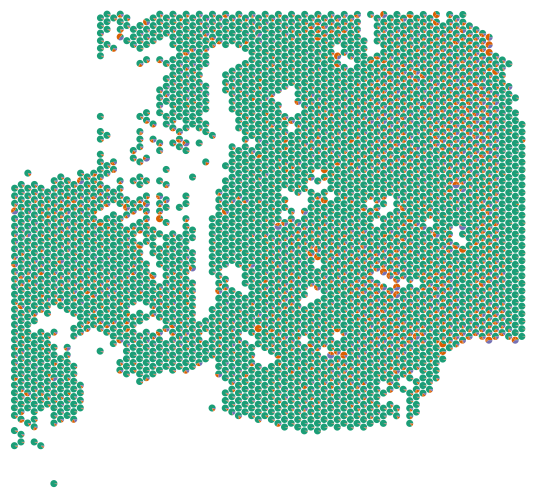

In [233]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

#### constrained mode

In [194]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 403 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in constrained mode...


Score: 0.314, KL reg: 0.184, Count reg: 50417.113, Lambda f reg: 219.838
Score: 0.717, KL reg: 0.004, Count reg: 49906.023, Lambda f reg: 6.975
Score: 0.723, KL reg: 0.004, Count reg: 49901.781, Lambda f reg: 2.773
Score: 0.724, KL reg: 0.004, Count reg: 49900.566, Lambda f reg: 1.566
Score: 0.725, KL reg: 0.004, Count reg: 49900.031, Lambda f reg: 1.029
Score: 0.725, KL reg: 0.004, Count reg: 49899.738, Lambda f reg: 0.737
Score: 0.726, KL reg: 0.004, Count reg: 49899.559, Lambda f reg: 0.558
Score: 0.726, KL reg: 0.004, Count reg: 49899.438, Lambda f reg: 0.439
Score: 0.726, KL reg: 0.004, Count reg: 49899.355, Lambda f reg: 0.356
Score: 0.726, KL reg: 0.004, Count reg: 49899.293, Lambda f reg: 0.295


INFO:root:Saving results..


In [195]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [196]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.279565,0.861575,0.780209,0.845808,0.857360,0.843864,0.786184,0.752592,0.662796,0.750545,...,0.792676,0.571107,0.289362,0.793561,0.784350,0.871147,0.808704,0.946345,0.634118,0.598833
macrophage,0.199842,0.037123,0.033420,0.038562,0.034972,0.035456,0.041631,0.069677,0.152430,0.055122,...,0.047320,0.057814,0.200442,0.121007,0.023602,0.064180,0.057638,0.008601,0.082270,0.075862
Bcell,0.158660,0.028871,0.002091,0.020084,0.005173,0.032459,0.012954,0.046388,0.046769,0.017085,...,0.006700,0.089882,0.146066,0.004689,0.018043,0.019214,0.034962,0.007948,0.009654,0.068024
Tcell,0.257707,0.021568,0.174575,0.036876,0.068908,0.038358,0.042880,0.066809,0.070645,0.088391,...,0.010955,0.115836,0.231804,0.038251,0.042725,0.023329,0.016373,0.020550,0.065592,0.160655
stroma,0.104226,0.050863,0.009705,0.058670,0.033587,0.049863,0.116351,0.064533,0.067360,0.088858,...,0.142350,0.165361,0.132326,0.042492,0.131280,0.022130,0.082322,0.016556,0.208366,0.096627


In [237]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:07<00:00, 45.94it/s]


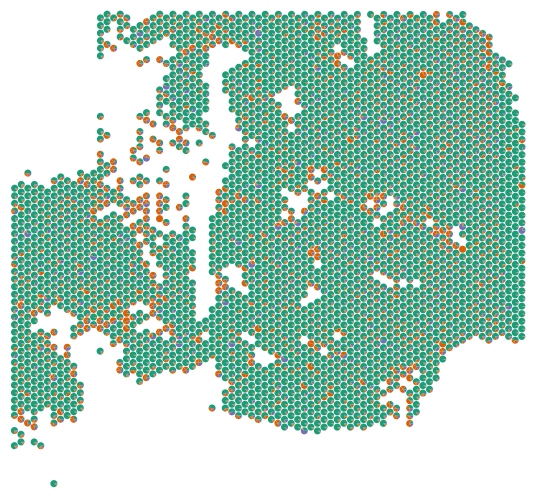

In [239]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

In [205]:
raw_port = deconv_df.T
raw_port

cell_type,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,1.000000,0.000000,0.000000
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.916667,0.083333,0.000000
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.916667,0.083333,0.000000
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.769231,0.230769,0.000000
TNBC_processed_adata_AACAGGTTCACCGAAG-1,1.000000,0.000000,0.000000
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,1.000000,0.000000,0.000000
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,1.000000,0.000000,0.000000
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.793103,0.000000,0.206897
TNBC_processed_adata_TGTTGGATGGACTTCT-1,1.000000,0.000000,0.000000


In [222]:
vis_decon = expr_deconv.T

In [223]:
vis_decon['Immune'] = vis_decon['macrophage'] + vis_decon['Bcell'] + vis_decon['Tcell']
vis_decon.drop(columns=['macrophage', 'Bcell', 'Tcell'], inplace=True)
vis_decon = vis_decon[['epithelial', 'Immune', 'stroma']]

In [225]:
vis_decon.columns = ['Epithelial', 'Immune', 'Stroma']
vis_decon

,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.279565,0.616209,0.104226
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.861575,0.087562,0.050863
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.780209,0.210087,0.009705
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.845808,0.095522,0.058670
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.857360,0.109053,0.033587
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.871147,0.106723,0.022130
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.808704,0.108974,0.082322
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.946345,0.037099,0.016556
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.634118,0.157516,0.208366


In [226]:
raw_port - vis_decon

cell_type,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.720435,-0.616209,-0.104226
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.055092,-0.004228,-0.050863
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.136458,-0.126753,-0.009705
TNBC_processed_adata_AACAGGTTATTGCACC-1,-0.076577,0.135247,-0.058670
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.142640,-0.109053,-0.033587
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.128853,-0.106723,-0.022130
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.191296,-0.108974,-0.082322
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,-0.153242,-0.037099,0.190341
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.365882,-0.157516,-0.208366


In [227]:
np.sqrt(((raw_port - vis_decon) ** 2).mean().mean())

0.22490037867414672

In [228]:
from scipy import stats

In [229]:
stats.pearsonr(raw_port['Epithelial'], vis_decon['Epithelial'])

PearsonRResult(statistic=0.4483845210672712, pvalue=2.055391464295716e-153)

In [232]:
stats.spearmanr(raw_port['Epithelial'], vis_decon['Epithelial'])

SignificanceResult(statistic=0.16343959730182517, pvalue=5.009405379383553e-20)

In [230]:
stats.pearsonr(raw_port['Immune'], vis_decon['Immune'])

PearsonRResult(statistic=0.46296817086051784, pvalue=9.985222557141024e-165)

In [233]:
stats.spearmanr(raw_port['Immune'], vis_decon['Immune'])

SignificanceResult(statistic=0.21001404022956033, pvalue=2.7952916011769165e-32)

In [231]:
stats.pearsonr(raw_port['Stroma'], vis_decon['Stroma'])

PearsonRResult(statistic=0.05583120076018981, pvalue=0.0018599522969158986)

In [234]:
stats.spearmanr(raw_port['Stroma'], vis_decon['Stroma'])

SignificanceResult(statistic=0.02309707681699867, pvalue=0.19827785587039598)

### Use all genes

In [189]:
# tg.pp_adatas(sc_data, ad_expr, genes=genes)
tg.pp_adatas(sc_data, ad_expr, genes=None)

INFO:root:14091 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:14091 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


#### Clusters mode

In [190]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    # mode="constrained",
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    # density_prior='uniform',
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 14091 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.256, KL reg: 0.456
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003
Score: 0.507, KL reg: 0.003


INFO:root:Saving results..


In [191]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [192]:
sc_data.obs['cell_type'].value_counts()

cell_type
epithelial    832
stroma         94
macrophage     64
Tcell          53
Bcell          19
Name: count, dtype: int64

In [193]:
for cell_type in ad_expr.obsm['tangram_ct_pred'].columns:
    ad_expr.obsm['tangram_ct_pred'][cell_type]=ad_expr.obsm['tangram_ct_pred'][cell_type]*sc_data.obs['cell_type'].value_counts()[cell_type]

In [194]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]

In [195]:
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.842472,0.996403,0.926964,0.976036,0.808162,0.989134,0.861383,0.884344,0.714548,0.781801,...,0.666896,0.792480,0.621422,0.959453,0.949264,0.870539,0.812469,0.998377,0.425863,0.794739
macrophage,0.039589,0.000329,0.018006,0.004920,0.055882,0.000349,0.027317,0.015938,0.072263,0.050233,...,0.105299,0.053975,0.130037,0.007315,0.015234,0.038149,0.054818,0.000319,0.145164,0.051146
Bcell,0.016134,0.000033,0.005272,0.000494,0.010512,0.000480,0.008686,0.001705,0.017955,0.014165,...,0.025688,0.010954,0.003320,0.003056,0.004434,0.009693,0.013476,0.000069,0.039546,0.021106
Tcell,0.016889,0.000184,0.024145,0.011690,0.041966,0.007456,0.038348,0.023070,0.072730,0.049202,...,0.078113,0.044385,0.126916,0.017244,0.015550,0.029710,0.040775,0.000428,0.124281,0.054366
stroma,0.084917,0.003052,0.025613,0.006860,0.083478,0.002581,0.064267,0.074943,0.122504,0.104599,...,0.124004,0.098207,0.118304,0.012932,0.015518,0.051909,0.078463,0.000807,0.265145,0.078643


In [196]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:09<00:00, 44.87it/s]


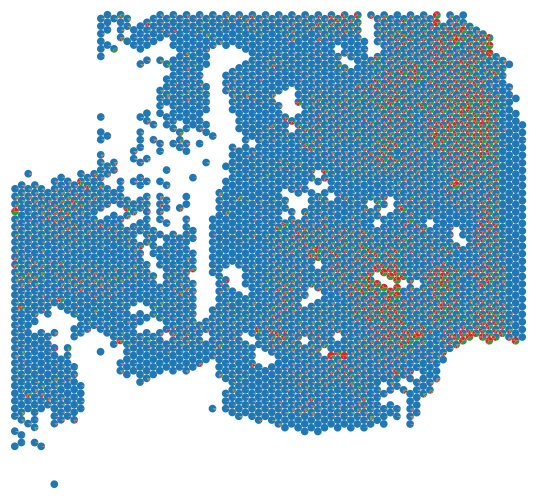

In [197]:
plt_pie_chart(data, coord)

#### constrained mode

In [198]:
ad_map = tg.map_cells_to_space(sc_data, ad_expr, 
    mode="constrained",
    # mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',
    scale=False,
    # density_prior='uniform',
    target_count=ad_expr.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 14091 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in constrained mode...


Score: 0.311, KL reg: 0.183, Count reg: 50444.352, Lambda f reg: 219.404
Score: 0.570, KL reg: 0.004, Count reg: 49906.191, Lambda f reg: 7.139
Score: 0.572, KL reg: 0.003, Count reg: 49901.840, Lambda f reg: 2.832
Score: 0.573, KL reg: 0.003, Count reg: 49900.602, Lambda f reg: 1.598
Score: 0.573, KL reg: 0.003, Count reg: 49900.051, Lambda f reg: 1.050
Score: 0.574, KL reg: 0.003, Count reg: 49899.754, Lambda f reg: 0.752
Score: 0.574, KL reg: 0.003, Count reg: 49899.570, Lambda f reg: 0.569
Score: 0.574, KL reg: 0.003, Count reg: 49899.449, Lambda f reg: 0.448
Score: 0.574, KL reg: 0.003, Count reg: 49899.363, Lambda f reg: 0.363
Score: 0.574, KL reg: 0.003, Count reg: 49899.301, Lambda f reg: 0.301


INFO:root:Saving results..


In [199]:
tg.project_cell_annotations(ad_map, ad_expr, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [200]:
ad_expr.obsm['tangram_ct_pred'] = ad_expr.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]

In [201]:
expr_deconv = ad_expr.obsm['tangram_ct_pred'].T/ad_expr.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.630619,0.828448,0.842221,0.806810,0.742864,0.790670,0.794459,0.650531,0.686229,0.777933,...,0.744255,0.667616,0.601091,0.828381,0.814376,0.830332,0.771959,0.908805,0.763520,0.581885
macrophage,0.094085,0.038499,0.036495,0.053465,0.098418,0.047207,0.036648,0.039945,0.095177,0.046631,...,0.078244,0.122847,0.288521,0.032208,0.048151,0.046104,0.100706,0.018724,0.067691,0.126681
Bcell,0.035863,0.024365,0.006701,0.013715,0.004117,0.022466,0.013294,0.016013,0.008733,0.011913,...,0.024578,0.012993,0.006999,0.017670,0.016971,0.008698,0.014992,0.021244,0.008602,0.080179
Tcell,0.081336,0.031079,0.043946,0.048535,0.051476,0.055861,0.054940,0.063382,0.087767,0.079647,...,0.068689,0.054641,0.033495,0.043089,0.046752,0.039794,0.033829,0.019374,0.046776,0.079537
stroma,0.158097,0.077609,0.070637,0.077475,0.103124,0.083796,0.100659,0.230129,0.122094,0.083876,...,0.084234,0.141903,0.069894,0.078652,0.073750,0.075072,0.078514,0.031852,0.113411,0.131718


In [202]:
data = np.array(expr_deconv.T)
coordinates = np.array([ad_expr.obsm['spatial'][:, 0], -ad_expr.obsm['spatial'][:, 1]]).T/ad_expr.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:13<00:00, 41.96it/s]


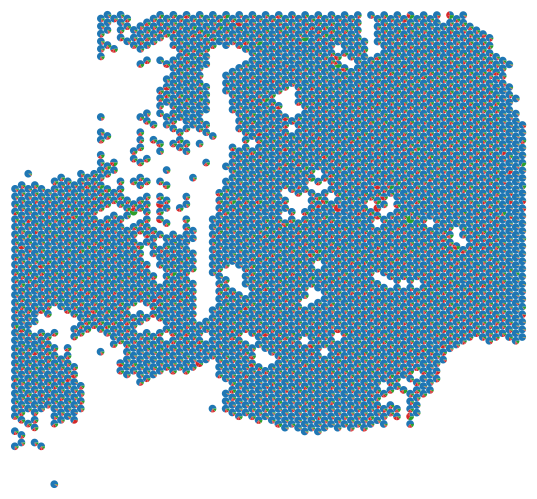

In [203]:
plt_pie_chart(data, coord)

## Use embedding

### After finetune all

In [119]:
case_name = '_finetune10'

In [116]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [117]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)

In [118]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [120]:
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3280 × 14263
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'spatial'
    obsm: 'X_pca', 'spatial'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [121]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)

In [122]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [123]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [124]:
txt_ad

AnnData object with n_obs × n_vars = 3280 × 766
    obs: 'uniform_density', 'rna_count_based_density'
    var: 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [125]:
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 764
    obs: 'cell_type'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [127]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9866e-05, 2.3839e-04, 4.7679e-04,  ..., 5.7612e-04, 1.7879e-04,
        9.9331e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.045, KL reg: 0.535
Score: 0.116, KL reg: 0.005
Score: 0.118, KL reg: 0.004
Score: 0.119, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004
Score: 0.120, KL reg: 0.004


INFO:root:Saving results..


In [128]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


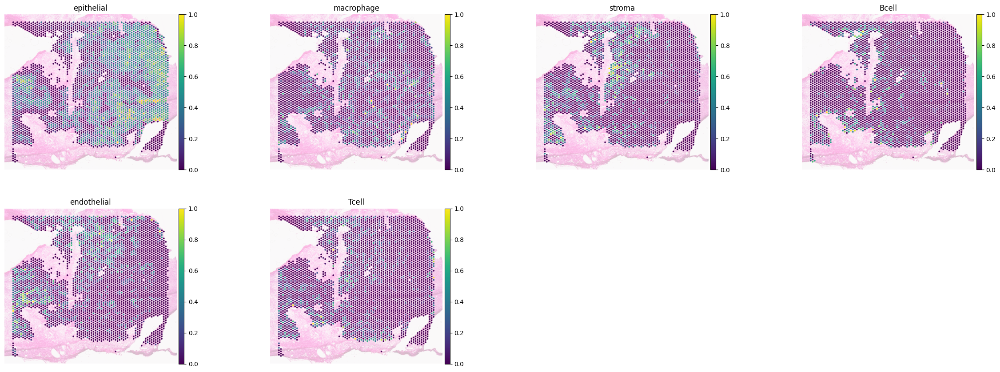

In [129]:
annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
tg.plot_cell_annotation_sc(txt_ad, annotation_list, x='x', y='y', perc=0.001, alpha_img=0.3)

In [132]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 768
    obs: 'cell_type'

In [130]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)

In [131]:
img_ad = anndata.AnnData(image_features[ad.obs.index].T)
img_ad.uns['spatial']=ad.uns['spatial'].copy()
img_ad.obsm['spatial']=ad.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3280 × 768
    uns: 'spatial'
    obsm: 'spatial'

In [133]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [134]:
img_ad

AnnData object with n_obs × n_vars = 3280 × 766
    obs: 'uniform_density', 'rna_count_based_density'
    var: 'n_cells'
    uns: 'spatial', 'training_genes', 'overlap_genes'
    obsm: 'spatial'

In [135]:
sc_ad_emb

AnnData object with n_obs × n_vars = 1112 × 764
    obs: 'cell_type'
    var: 'n_cells'
    uns: 'training_genes', 'overlap_genes'

In [136]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cuda', 
    scale=False,
    # density_prior='uniform'
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9866e-05, 2.3839e-04, 4.7679e-04,  ..., 5.7612e-04, 1.7879e-04,
        9.9331e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.066, KL reg: 0.558
Score: 0.123, KL reg: 0.005
Score: 0.126, KL reg: 0.004
Score: 0.127, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004
Score: 0.128, KL reg: 0.004


INFO:root:Saving results..


In [137]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


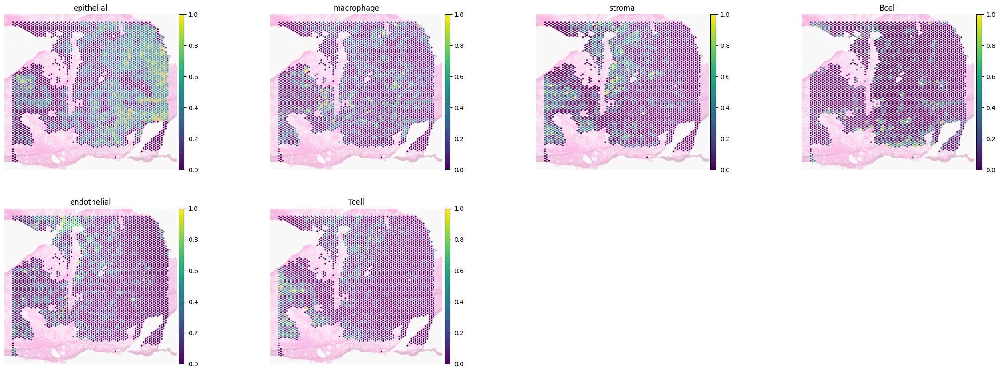

In [138]:
annotation_list = list(pd.unique(sc_ad_emb.obs['cell_type']))
tg.plot_cell_annotation_sc(img_ad, annotation_list, x='x', y='y', perc=0.001, alpha_img=0.3)

### Before finetune

In [293]:
case_name = '_training20'

In [294]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [295]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [296]:
sc.pp.filter_cells(sc_data, min_genes=100)

In [297]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]

#### TXT

In [298]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [299]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [300]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [301]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [302]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


##### Clusters Mode

In [303]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    cluster_label='cell_type',
    device='cpu', 
    # device='cuda', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.164, KL reg: 0.481
Score: 0.236, KL reg: 0.002
Score: 0.238, KL reg: 0.002
Score: 0.238, KL reg: 0.002
Score: 0.238, KL reg: 0.002
Score: 0.238, KL reg: 0.001
Score: 0.238, KL reg: 0.001
Score: 0.238, KL reg: 0.001
Score: 0.238, KL reg: 0.001
Score: 0.238, KL reg: 0.001


INFO:root:Saving results..


In [304]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [305]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [306]:
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.007396,0.458638,0.870039,0.585395,0.891489,0.504596,0.705130,0.008386,0.510840,0.243812,...,0.880257,0.012541,0.055825,0.801628,0.753616,0.890066,0.900726,0.884361,0.436821,0.062792
macrophage,0.834636,0.099440,0.105639,0.079877,0.080768,0.176030,0.086589,0.154011,0.155804,0.000255,...,0.002608,0.180899,0.809803,0.105103,0.153488,0.010415,0.003417,0.000827,0.049735,0.552917
Bcell,0.122183,0.060853,0.015687,0.075020,0.014225,0.083029,0.000507,0.193982,0.138675,0.001975,...,0.000102,0.122782,0.002475,0.023402,0.033419,0.016291,0.000051,0.000027,0.000018,0.300603
Tcell,0.013408,0.075028,0.000086,0.056426,0.013426,0.148045,0.108459,0.002268,0.000108,0.278019,...,0.011645,0.115140,0.129143,0.034228,0.059212,0.009482,0.039564,0.000150,0.091782,0.000441
stroma,0.022377,0.306041,0.008549,0.203281,0.000092,0.088301,0.099315,0.641352,0.194572,0.475939,...,0.105388,0.568638,0.002754,0.035640,0.000266,0.073746,0.056242,0.114635,0.421644,0.083247


In [307]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:05<00:00, 47.09it/s]


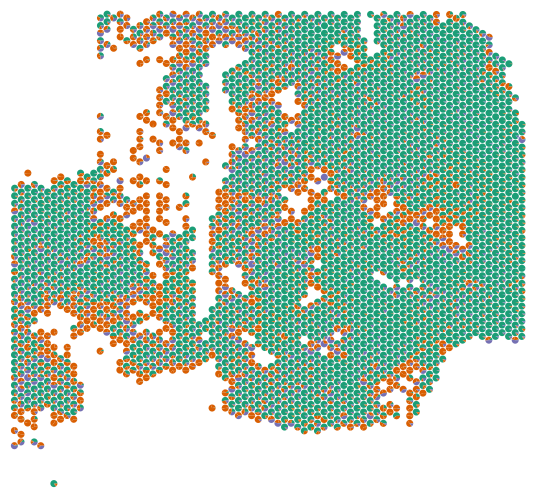

In [308]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

#### Img

In [309]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [310]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [311]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [312]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:729 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:729 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


##### Clusters Mode

In [313]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 729 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.064, KL reg: 0.468
Score: 0.110, KL reg: 0.001
Score: 0.113, KL reg: 0.001
Score: 0.113, KL reg: 0.001
Score: 0.113, KL reg: 0.001
Score: 0.114, KL reg: 0.001
Score: 0.114, KL reg: 0.001
Score: 0.114, KL reg: 0.001
Score: 0.114, KL reg: 0.001
Score: 0.114, KL reg: 0.001


INFO:root:Saving results..


In [314]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [315]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [316]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.031491,0.701058,0.867646,0.301257,0.920178,0.462511,0.754598,0.008528,0.396020,0.604783,...,9.134758e-01,0.017475,0.027138,0.807511,0.686685,0.927545,0.946175,0.929954,0.226585,0.047715
macrophage,0.698829,0.054597,0.087250,0.056741,0.079664,0.185168,0.093509,0.000143,0.000453,0.224524,...,8.593520e-02,0.724283,0.005672,0.100299,0.059864,0.020989,0.053616,0.068363,0.021390,0.104228
Bcell,0.001303,0.000038,0.026871,0.000582,0.000011,0.032941,0.000062,0.385179,0.000205,0.000013,...,9.915182e-07,0.000072,0.963738,0.020869,0.000019,0.006111,0.000007,0.000110,0.000045,0.151672
Tcell,0.000212,0.156093,0.000009,0.156722,0.000065,0.067568,0.000263,0.000869,0.207725,0.000028,...,1.303572e-04,0.000462,0.000454,0.000059,0.016411,0.045343,0.000038,0.000271,0.368298,0.135223
stroma,0.268164,0.088215,0.018224,0.484698,0.000082,0.251811,0.151568,0.605282,0.395597,0.170652,...,4.576793e-04,0.257708,0.002998,0.071263,0.237021,0.000013,0.000164,0.001301,0.383683,0.561162


In [317]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:06<00:00, 46.67it/s]


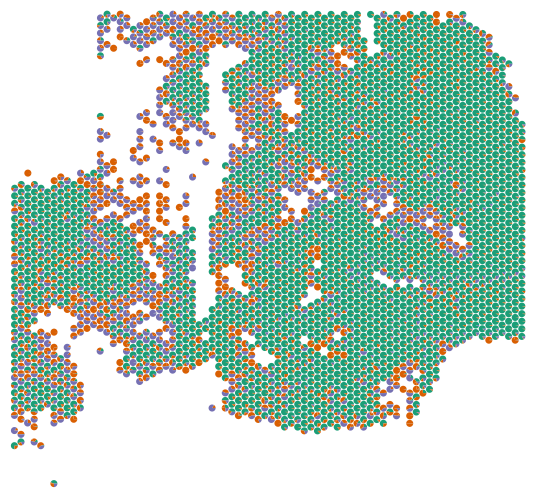

In [318]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

### After finetune rb

In [54]:
# case_name = '_finetune10_rb'
case_name = '_finetune10_filter100g_rb'

In [55]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [56]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [57]:
sc.pp.filter_cells(sc_data, min_genes=100)

In [58]:
sc_data.obs['cell_type'].value_counts()/sc_data.obs['cell_type'].value_counts().sum()

cell_type
epithelial    0.783427
stroma        0.088512
macrophage    0.060264
Tcell         0.049906
Bcell         0.017891
Name: count, dtype: float64

In [59]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]
sc_text_features

,PT089_P1_A01,PT089_P1_A02,PT089_P1_A03,PT089_P1_A04,PT089_P1_A05,PT089_P1_A06,PT089_P1_A07,PT089_P1_A08,PT089_P1_A09,PT089_P1_A10,...,PT039_P10_H02_S278,PT039_P10_H03_S279,PT039_P10_H04_S280,PT039_P10_H05_S281,PT039_P10_H06_S282,PT039_P10_H07_S283,PT039_P10_H08_S284,PT039_P10_H09_S285,PT039_P10_H11_S287,PT039_P10_H12_S288
0,-0.004370,-0.018342,-0.038492,-0.021264,-0.016200,-0.028461,-0.007818,-0.017296,-0.029160,-0.030547,...,-0.026721,-0.017721,0.005674,0.006504,-0.050437,0.009004,-0.001323,0.026136,-0.012262,0.012356
1,0.020638,-0.000981,0.011747,-0.005916,0.004556,-0.019420,0.024464,0.002920,0.008565,0.016434,...,-0.006399,0.004778,-0.005036,-0.014482,-0.001268,0.025794,0.028276,0.021582,-0.004581,0.039601
2,0.006078,0.004170,0.026823,-0.027532,0.005530,0.016792,-0.012087,-0.040259,-0.010968,0.010741,...,-0.007953,-0.008736,-0.021914,-0.026697,-0.036127,-0.017661,-0.003949,0.002254,0.030900,-0.009856
3,0.008912,0.012666,0.018083,-0.037484,0.015755,0.035843,-0.022695,-0.036084,-0.023130,-0.050101,...,0.011369,-0.005890,-0.052062,0.048698,0.046990,0.006947,0.000432,0.029525,-0.021085,-0.008984
4,0.017105,0.028398,0.047296,-0.008333,-0.018580,0.023832,0.000338,-0.001559,0.019886,0.014469,...,0.006374,-0.032945,-0.018369,0.003547,-0.021884,-0.003707,0.003383,0.022154,0.002456,0.004328
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,-0.002891,-0.036005,0.019523,-0.036422,0.006401,0.009183,-0.011295,-0.085295,-0.045393,-0.033524,...,-0.018082,-0.049442,-0.066876,-0.019250,0.010201,-0.033529,-0.023724,0.050163,-0.041596,-0.031048
764,-0.028558,-0.054545,-0.009281,-0.057165,-0.056121,-0.024147,0.002596,-0.088172,0.001663,-0.027428,...,0.005925,-0.053612,-0.060610,-0.041341,-0.024150,-0.066399,-0.057861,-0.055180,-0.049297,-0.040574
765,-0.010737,-0.036089,-0.028215,-0.018311,-0.025756,-0.035939,0.007228,-0.007526,-0.033735,0.011877,...,-0.016501,-0.003161,-0.008451,-0.023398,0.012955,-0.033284,-0.050992,-0.016674,-0.006601,-0.020573
766,0.019656,0.033885,0.025148,0.005779,-0.022579,0.019282,0.022807,-0.007924,0.009977,-0.004712,...,-0.005685,0.003632,-0.040678,-0.016644,-0.062211,-0.011056,0.001866,-0.019046,0.003040,-0.002661


#### txt

In [60]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [61]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [62]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [63]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [70]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [71]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',                            
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.084, KL reg: 0.461
Score: 0.155, KL reg: 0.002
Score: 0.157, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002
Score: 0.158, KL reg: 0.002


INFO:root:Saving results..


In [72]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [73]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [74]:
txt_ad.obsm['tangram_ct_pred'].sum()
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.005483,0.485646,0.944215,0.564797,9.995879e-01,0.317691,0.784713,0.003035,0.738727,0.082878,...,0.946448,0.114299,0.486838,0.698832,0.944950,0.950910,0.929530,8.520119e-01,0.316647,0.001030
macrophage,0.657325,0.035261,0.047635,0.112279,2.306936e-04,0.002892,0.068306,0.075411,0.014573,0.000873,...,0.000394,0.011704,0.145398,0.228845,0.000644,0.038733,0.042091,2.249641e-02,0.104967,0.779156
Bcell,0.001894,0.189992,0.000018,0.064800,6.387412e-07,0.102657,0.000044,0.215518,0.168956,0.000082,...,0.000004,0.164477,0.000115,0.004249,0.053848,0.000036,0.000058,7.861275e-07,0.000098,0.218856
Tcell,0.283391,0.000217,0.000012,0.000057,3.274004e-05,0.480099,0.066864,0.000450,0.018998,0.317137,...,0.000015,0.000190,0.006789,0.000240,0.000517,0.000163,0.000056,4.686871e-05,0.000118,0.000256
stroma,0.051907,0.288884,0.008120,0.258067,1.480656e-04,0.096662,0.080073,0.705585,0.058746,0.599030,...,0.053139,0.709330,0.360860,0.067833,0.000040,0.010158,0.028265,1.254441e-01,0.578171,0.000702


In [75]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:00<00:00, 51.06it/s]


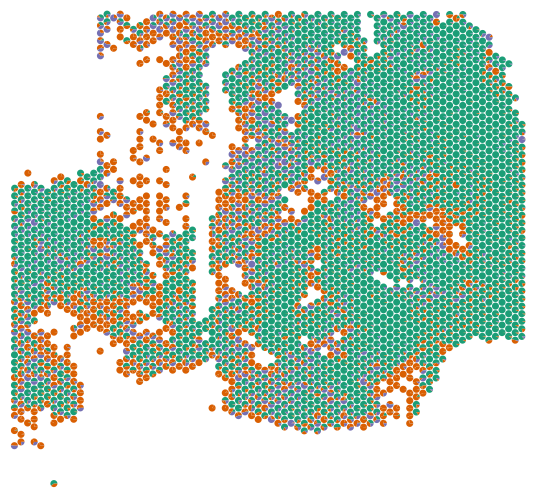

In [76]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

#### img

In [77]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [78]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [79]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [80]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [81]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.085, KL reg: 0.477
Score: 0.144, KL reg: 0.001
Score: 0.146, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001
Score: 0.147, KL reg: 0.001


INFO:root:Saving results..


In [82]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [83]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [84]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.005213,0.422438,0.865345,0.339910,0.999328,0.007668,0.692769,0.000945,0.372042,0.246968,...,0.815605,0.038121,0.000726,0.873267,0.617028,0.962677,0.961409,0.997434,0.288403,0.002410
macrophage,0.331685,0.094176,0.098301,0.157752,0.000407,0.314662,0.064969,0.000172,0.000286,0.307712,...,0.117501,0.678489,0.000756,0.000053,0.000738,0.017963,0.038501,0.002324,0.000402,0.144190
Bcell,0.653050,0.025190,0.035961,0.000059,0.000037,0.037574,0.000048,0.281777,0.000393,0.000004,...,0.000010,0.256809,0.708218,0.043399,0.000132,0.000051,0.000003,0.000012,0.000019,0.167100
Tcell,0.001063,0.149284,0.000304,0.000704,0.000078,0.134539,0.000061,0.044863,0.263568,0.000122,...,0.000014,0.001216,0.000187,0.000125,0.210083,0.018973,0.000046,0.000084,0.233952,0.000162
stroma,0.008989,0.308912,0.000090,0.501576,0.000151,0.505558,0.242153,0.672244,0.363711,0.445194,...,0.066870,0.025365,0.290113,0.083155,0.172019,0.000336,0.000041,0.000147,0.477224,0.686138


In [85]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:03<00:00, 48.60it/s]


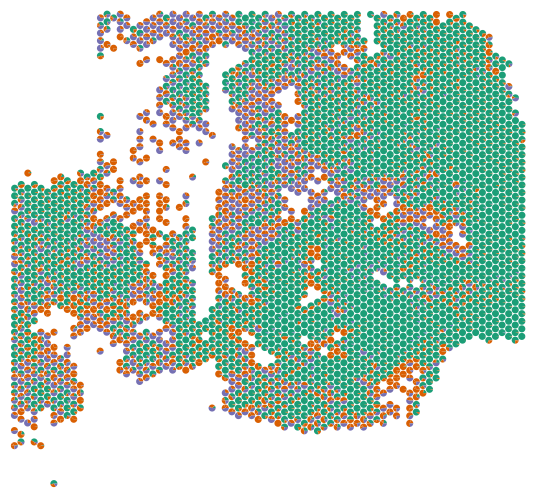

In [86]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

100%|██████████| 3104/3104 [01:07<00:00, 46.05it/s]


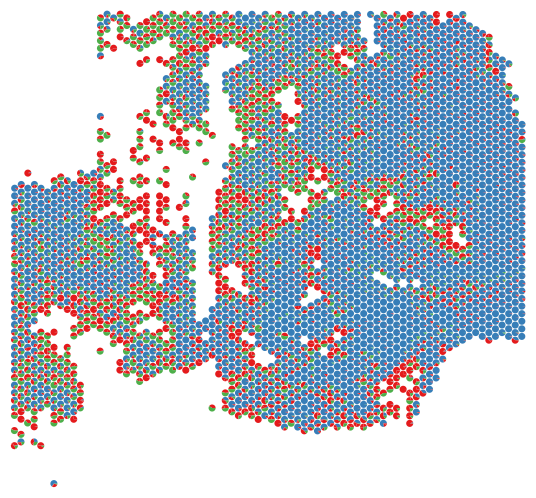

In [201]:
colors = cmap([1, 0, 0, 0, 2])
plt_pie_chart(data, coordinates, colors)

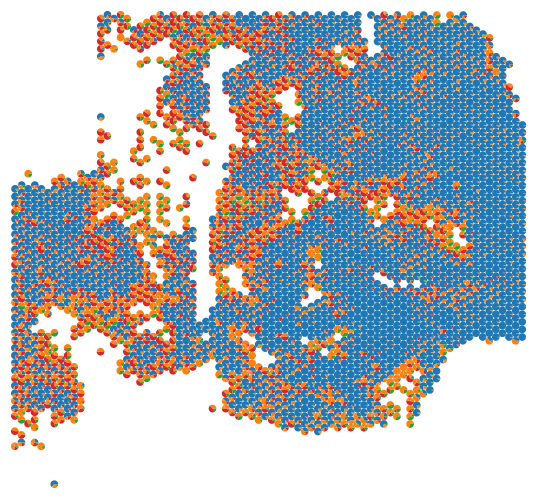

CPU times: user 2min 11s, sys: 1.41 s, total: 2min 12s
Wall time: 2min 13s


In [211]:
fig = plt.figure(figsize=(8, 8))
cmap = plt.colormaps["tab10"]

for i in tqdm(range(data.shape[0])):
    sizes = data[i]
    coord = coordinates[i]
    subax = fig.add_axes([coord[0], coord[1], 0.012, 0.012])
    subax.pie(sizes, 
              colors=cmap([0, 1, 1, 1, 3, 2])
              # colors=['red', 'green', 'blue']
             )  # Including percentage labels
    subax.set_aspect('equal')  # Ensure the pie is drawn as a circle.

plt.show()

### After finetune rt

In [38]:
# case_name = '_finetune10_rb'
case_name = '_finetune10_filter100g_rt'

In [39]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [40]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [41]:
sc.pp.filter_cells(sc_data, min_genes=100)

In [42]:
sc_data.obs['cell_type'].value_counts()/sc_data.obs['cell_type'].value_counts().sum()

cell_type
epithelial    0.783427
stroma        0.088512
macrophage    0.060264
Tcell         0.049906
Bcell         0.017891
Name: count, dtype: float64

In [48]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]
sc_text_features

,PT089_P1_A01,PT089_P1_A02,PT089_P1_A03,PT089_P1_A04,PT089_P1_A05,PT089_P1_A06,PT089_P1_A07,PT089_P1_A08,PT089_P1_A09,PT089_P1_A10,...,PT039_P10_H02_S278,PT039_P10_H03_S279,PT039_P10_H04_S280,PT039_P10_H05_S281,PT039_P10_H06_S282,PT039_P10_H07_S283,PT039_P10_H08_S284,PT039_P10_H09_S285,PT039_P10_H11_S287,PT039_P10_H12_S288
0,-0.000603,-0.002869,-0.027716,-0.016867,-0.011864,-0.019945,-0.002586,-0.011836,-0.021252,-0.020274,...,-0.022867,-0.021462,0.007396,0.014460,-0.047480,0.012227,0.005443,0.027880,-0.005465,0.008675
1,0.012317,-0.010588,-0.001766,-0.002646,0.003075,-0.024870,0.018044,-0.005390,0.003392,0.005928,...,-0.010337,0.004638,-0.013923,-0.026855,-0.003166,0.023532,0.024580,0.021424,-0.010032,0.045288
2,0.015811,0.008670,0.030001,-0.024017,0.005022,0.021668,-0.016660,-0.043138,-0.005395,0.010666,...,-0.002502,-0.005835,-0.019481,-0.019516,-0.036969,-0.018215,-0.003050,0.006577,0.033630,-0.005908
3,0.013664,0.003803,0.016995,-0.042688,0.013438,0.031365,-0.028515,-0.036381,-0.016030,-0.055829,...,0.013534,-0.003077,-0.061706,0.044170,0.052062,-0.001218,-0.004531,0.034199,-0.038733,-0.008997
4,0.033325,0.044117,0.059874,0.000402,-0.011048,0.040254,0.020891,0.013270,0.031266,0.034784,...,0.015942,-0.029541,-0.008931,0.009198,-0.022107,0.000900,0.008862,0.032029,0.010738,0.007138
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,-0.000192,-0.019292,0.018889,-0.041392,0.008877,0.021674,-0.002651,-0.086873,-0.048197,-0.042756,...,-0.023457,-0.065104,-0.086165,-0.033173,-0.002305,-0.019990,-0.025894,0.051739,-0.049034,-0.041779
764,-0.044720,-0.083461,-0.020092,-0.059972,-0.063314,-0.040005,-0.013724,-0.094156,-0.014428,-0.037332,...,-0.006725,-0.068953,-0.060763,-0.052465,-0.033124,-0.087673,-0.063402,-0.059230,-0.060214,-0.047844
765,-0.007542,-0.029661,-0.029774,-0.016881,-0.030662,-0.032478,0.005983,-0.004068,-0.045220,0.008365,...,-0.014725,-0.004097,-0.013448,-0.026210,0.004903,-0.033584,-0.051793,-0.014548,-0.008962,-0.024584
766,0.010514,0.028973,0.012819,0.006579,-0.025541,0.013911,0.016636,-0.011083,-0.000185,-0.012955,...,-0.000895,0.005671,-0.041228,-0.020519,-0.054328,-0.011551,0.003623,-0.017896,-0.004905,-0.001058


#### txt

In [49]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [50]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [51]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [52]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [53]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [54]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',                            
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.094, KL reg: 0.461
Score: 0.166, KL reg: 0.002
Score: 0.169, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001
Score: 0.170, KL reg: 0.001


INFO:root:Saving results..


In [55]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [56]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [57]:
txt_ad.obsm['tangram_ct_pred'].sum()
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.006404,0.317524,0.717239,0.371144,0.827954,0.185993,0.519881,0.002667,0.583377,0.149877,...,0.932611,0.006940,0.017328,0.559533,0.598621,0.960119,0.932935,0.948139,0.588866,0.000559
macrophage,0.384623,0.231711,0.081665,0.060245,0.116532,0.078799,0.166264,0.002109,0.127777,0.002051,...,0.048117,0.006659,0.786588,0.234326,0.145494,0.009819,0.004079,0.005085,0.000038,0.581935
Bcell,0.002615,0.080769,0.000104,0.095168,0.005985,0.064304,0.001342,0.081441,0.141738,0.019800,...,0.000014,0.304526,0.000168,0.007348,0.046142,0.029494,0.000114,0.014381,0.000137,0.299261
Tcell,0.604365,0.000128,0.000028,0.000040,0.049407,0.325135,0.122878,0.000430,0.031662,0.002542,...,0.019016,0.000060,0.004300,0.000141,0.113850,0.000499,0.062027,0.030539,0.000303,0.000247
stroma,0.001993,0.369868,0.200964,0.473403,0.000121,0.345768,0.189634,0.913353,0.115445,0.825731,...,0.000243,0.681815,0.191616,0.198652,0.095892,0.000068,0.000844,0.001857,0.410656,0.117998


In [58]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [00:56<00:00, 54.76it/s]


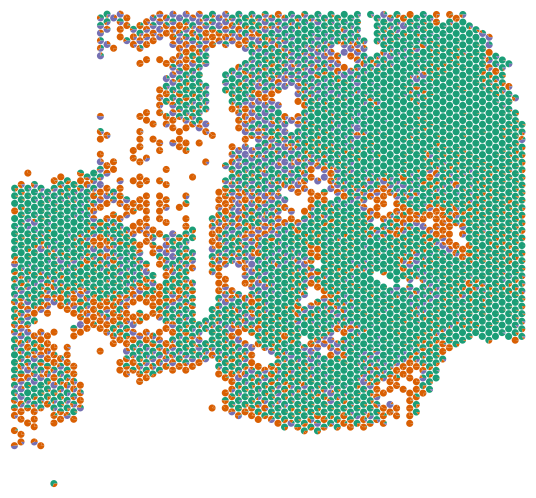

In [62]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

#### img

In [63]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [64]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [65]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [66]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [67]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.094, KL reg: 0.477
Score: 0.159, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.162, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001
Score: 0.163, KL reg: 0.001


INFO:root:Saving results..


In [68]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [69]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [70]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.012805,0.661965,0.874643,0.638208,0.876638,0.402108,0.645098,0.004793,0.668396,0.318757,...,0.877834,0.025145,0.002678,0.859961,0.705549,0.843704,0.957052,0.905184,0.005386,0.002821
macrophage,0.725433,0.034288,0.089619,0.133443,0.084388,0.284503,0.000952,0.000096,0.000316,0.182253,...,0.041899,0.562752,0.000946,0.098987,0.000330,0.000040,0.039895,0.085376,0.177729,0.222680
Bcell,0.227869,0.000021,0.035233,0.053726,0.001479,0.055507,0.000034,0.240540,0.012534,0.000007,...,0.000015,0.283498,0.830383,0.039185,0.000079,0.000493,0.000011,0.000052,0.000074,0.033190
Tcell,0.002895,0.020241,0.000234,0.000449,0.037262,0.000388,0.000026,0.116941,0.005959,0.000189,...,0.000018,0.001164,0.000722,0.000085,0.000222,0.155383,0.003006,0.008967,0.324612,0.173611
stroma,0.030998,0.283485,0.000272,0.174174,0.000233,0.257494,0.353890,0.637629,0.312794,0.498794,...,0.080234,0.127441,0.165271,0.001782,0.293820,0.000380,0.000036,0.000420,0.492199,0.567697


In [71]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [00:58<00:00, 52.63it/s]


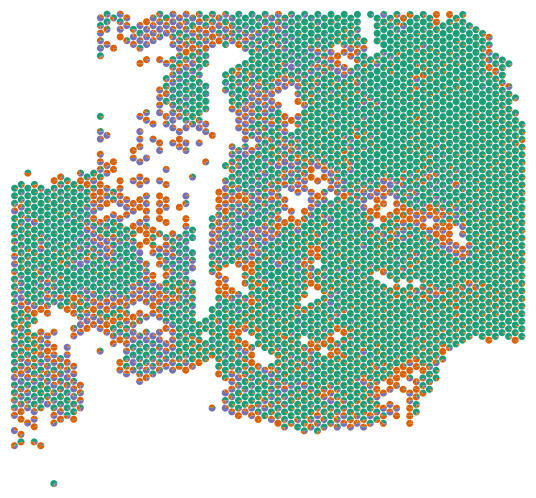

In [72]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

### After finetune lt

In [97]:
# case_name = '_finetune10_rb'
case_name = '_finetune10_filter100g_lt'

In [98]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [99]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [100]:
sc.pp.filter_cells(sc_data, min_genes=100)

In [101]:
sc_data.obs['cell_type'].value_counts()/sc_data.obs['cell_type'].value_counts().sum()

cell_type
epithelial    0.783427
stroma        0.088512
macrophage    0.060264
Tcell         0.049906
Bcell         0.017891
Name: count, dtype: float64

In [102]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]
sc_text_features

,PT089_P1_A01,PT089_P1_A02,PT089_P1_A03,PT089_P1_A04,PT089_P1_A05,PT089_P1_A06,PT089_P1_A07,PT089_P1_A08,PT089_P1_A09,PT089_P1_A10,...,PT039_P10_H02_S278,PT039_P10_H03_S279,PT039_P10_H04_S280,PT039_P10_H05_S281,PT039_P10_H06_S282,PT039_P10_H07_S283,PT039_P10_H08_S284,PT039_P10_H09_S285,PT039_P10_H11_S287,PT039_P10_H12_S288
0,0.010054,0.000950,-0.022754,-0.015430,-0.013574,-0.021691,0.005315,-0.002915,-0.023386,-0.017830,...,-0.019018,-0.010829,0.012026,0.009529,-0.046023,0.013706,0.008732,0.029560,-0.002619,0.012261
1,0.023877,0.000326,0.013354,-0.000571,0.010109,-0.020014,0.039234,0.007116,0.010502,0.018252,...,-0.003610,0.005406,0.001132,-0.018158,-0.003332,0.038678,0.030509,0.025832,-0.012486,0.052805
2,0.015386,0.009808,0.032577,-0.025330,0.006885,0.029642,-0.018075,-0.041706,-0.009070,0.012974,...,-0.003035,-0.009600,-0.013883,-0.024812,-0.037522,-0.016687,0.002508,0.002817,0.049890,-0.009859
3,0.029638,0.022824,0.028040,-0.030719,0.025663,0.043815,-0.011174,-0.023490,-0.010084,-0.053697,...,0.021448,-0.002159,-0.051612,0.055316,0.056986,0.016979,0.014259,0.036873,-0.020271,-0.001359
4,0.023937,0.036010,0.060723,-0.000781,-0.008983,0.032381,0.014774,0.001899,0.026443,0.021020,...,0.007696,-0.028592,-0.005977,0.006656,-0.027534,-0.000150,0.008494,0.028819,0.025681,0.007515
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,0.011985,-0.011002,0.034738,-0.023802,0.017823,0.025934,0.022732,-0.060157,-0.040922,-0.020680,...,-0.011241,-0.044307,-0.058360,-0.009710,0.007242,-0.001335,-0.012019,0.054813,-0.014283,-0.026246
764,-0.032135,-0.070702,-0.011143,-0.055090,-0.049073,-0.026163,0.003686,-0.091794,-0.003702,-0.024259,...,0.008386,-0.066646,-0.057090,-0.037372,-0.030681,-0.066395,-0.060687,-0.048635,-0.054833,-0.040904
765,-0.028016,-0.053308,-0.042230,-0.033363,-0.039582,-0.052022,-0.010158,-0.025191,-0.053847,0.002219,...,-0.021361,-0.011945,-0.019041,-0.039181,-0.000938,-0.051683,-0.057550,-0.023008,-0.023608,-0.033851
766,0.020836,0.035906,0.025155,0.005255,-0.020272,0.017608,0.023195,-0.011495,0.012472,-0.004294,...,-0.002869,0.009708,-0.040880,-0.012973,-0.059074,-0.006224,0.005224,-0.017259,-0.009953,0.000350


#### txt

In [103]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [104]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [105]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [106]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [107]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [108]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',                            
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.075, KL reg: 0.461
Score: 0.143, KL reg: 0.002
Score: 0.145, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002
Score: 0.146, KL reg: 0.002


INFO:root:Saving results..


In [109]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [110]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [111]:
txt_ad.obsm['tangram_ct_pred'].sum()
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.003501,0.237394,0.914327,0.647575,9.834087e-01,0.036538,0.723041,0.002082,0.346294,0.033218,...,0.994305,0.010857,0.022780,0.640793,0.861015,0.933751,0.997344,0.860817,0.374424,0.000924
macrophage,0.821438,0.119416,0.072183,0.017466,1.637442e-02,0.000874,0.149937,0.000207,0.253105,0.000660,...,0.000105,0.362554,0.940495,0.165823,0.001050,0.000585,0.000921,0.004190,0.000060,0.749409
Bcell,0.170320,0.089545,0.000055,0.029146,7.345677e-07,0.041846,0.000059,0.142616,0.086685,0.020092,...,0.000005,0.006403,0.000082,0.003247,0.012559,0.000407,0.000155,0.000001,0.000123,0.248078
Tcell,0.002878,0.079019,0.000070,0.092423,4.288486e-05,0.446901,0.070832,0.001053,0.027362,0.276942,...,0.000017,0.151593,0.004678,0.045235,0.125267,0.008436,0.000349,0.000191,0.107826,0.000624
stroma,0.001863,0.474625,0.013366,0.213390,1.732780e-04,0.473841,0.056130,0.854042,0.286554,0.669089,...,0.005568,0.468592,0.031965,0.144902,0.000109,0.056820,0.001231,0.134800,0.517567,0.000967


In [112]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [00:56<00:00, 55.32it/s]


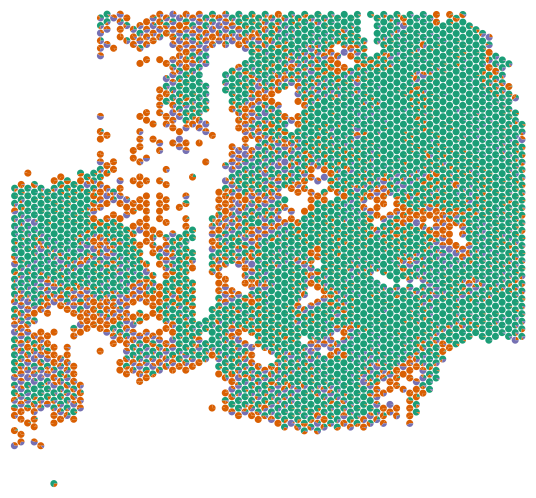

In [113]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

#### img

In [114]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [115]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [116]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [117]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:763 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:763 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [118]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 763 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.021, KL reg: 0.477
Score: 0.085, KL reg: 0.003
Score: 0.088, KL reg: 0.003
Score: 0.089, KL reg: 0.003
Score: 0.089, KL reg: 0.003
Score: 0.089, KL reg: 0.003
Score: 0.089, KL reg: 0.003
Score: 0.090, KL reg: 0.003
Score: 0.090, KL reg: 0.003
Score: 0.090, KL reg: 0.003


INFO:root:Saving results..


In [119]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [120]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [121]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.002646,0.126830,0.886361,0.173988,0.999450,0.003316,0.813874,0.000442,0.704231,0.004343,...,0.883206,0.004348,0.001046,0.956889,0.913555,0.999538,0.996517,0.969797,0.003175,0.001111
macrophage,0.291786,0.015591,0.113535,0.143716,0.000417,0.005386,0.000269,0.000040,0.000347,0.438884,...,0.116711,0.972024,0.000879,0.009070,0.000412,0.000201,0.003433,0.029995,0.001212,0.000016
Bcell,0.702328,0.000011,0.000026,0.000065,0.000009,0.000445,0.000011,0.310890,0.000003,0.000003,...,0.000008,0.022522,0.996283,0.000007,0.000024,0.000007,0.000001,0.000008,0.000069,0.146223
Tcell,0.000763,0.389598,0.000061,0.041442,0.000021,0.275598,0.000013,0.217410,0.000044,0.000100,...,0.000007,0.000110,0.000273,0.000042,0.000139,0.000070,0.000014,0.000058,0.453696,0.845471
stroma,0.002477,0.467969,0.000017,0.640789,0.000104,0.715255,0.185833,0.471218,0.295374,0.556670,...,0.000068,0.000996,0.001519,0.033993,0.085870,0.000185,0.000034,0.000142,0.541847,0.007178


In [122]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:00<00:00, 51.27it/s]


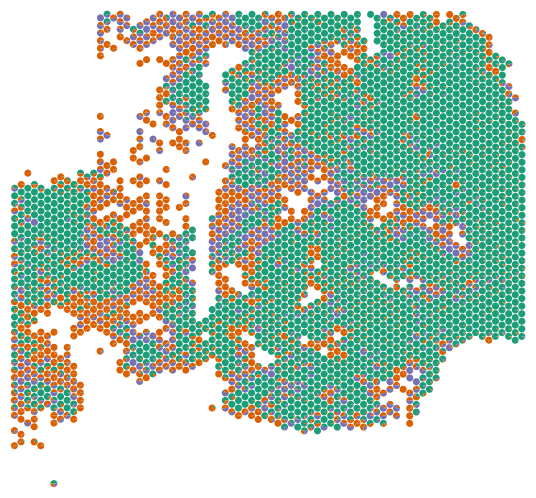

In [123]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

### After finetune lb

In [235]:
# case_name = '_finetune10_rb'
case_name = '_finetune10_filter100g_lb'

In [236]:
sc_data = sc.read_h5ad(sc_data_path)
sc_data

AnnData object with n_obs × n_vars = 1112 × 21785
    obs: 'cell_type'

In [237]:
sc_data = sc_data[sc_data.obs['cell_type']!='endothelial']
sc_data

View of AnnData object with n_obs × n_vars = 1098 × 21785
    obs: 'cell_type'

In [238]:
sc.pp.filter_cells(sc_data, min_genes=100)

In [239]:
sc_data.obs['cell_type'].value_counts()/sc_data.obs['cell_type'].value_counts().sum()

cell_type
epithelial    0.783427
stroma        0.088512
macrophage    0.060264
Tcell         0.049906
Bcell         0.017891
Name: count, dtype: float64

In [240]:
sc_text_feature_path = os.path.join(data_path, sample_name+'_txt_features_sc'+case_name+'.csv')
sc_text_features = pd.read_csv(sc_text_feature_path, index_col=0)[sc_data.obs.index]
sc_text_features

,PT089_P1_A01,PT089_P1_A02,PT089_P1_A03,PT089_P1_A04,PT089_P1_A05,PT089_P1_A06,PT089_P1_A07,PT089_P1_A08,PT089_P1_A09,PT089_P1_A10,...,PT039_P10_H02_S278,PT039_P10_H03_S279,PT039_P10_H04_S280,PT039_P10_H05_S281,PT039_P10_H06_S282,PT039_P10_H07_S283,PT039_P10_H08_S284,PT039_P10_H09_S285,PT039_P10_H11_S287,PT039_P10_H12_S288
0,0.002366,-0.013399,-0.033949,-0.013534,-0.012970,-0.025038,-0.007650,-0.006894,-0.028154,-0.018408,...,-0.021560,-0.019150,0.011360,0.000894,-0.046605,0.001597,0.001079,0.027408,-0.008950,0.012239
1,0.006931,-0.011500,0.005669,-0.015409,0.000112,-0.026686,0.016757,-0.009253,0.003497,0.002369,...,-0.010346,0.001479,-0.015684,-0.028763,-0.009696,0.017224,0.020151,0.016051,-0.013961,0.038203
2,0.007880,0.007238,0.030939,-0.020448,0.010522,0.022063,-0.014362,-0.036600,-0.011074,0.011248,...,-0.000901,-0.000147,-0.010220,-0.018863,-0.033489,-0.013299,-0.000649,0.005511,0.038639,-0.009359
3,0.007671,0.010273,0.016975,-0.038618,0.018900,0.028592,-0.029500,-0.024341,-0.023316,-0.057509,...,0.012074,-0.002492,-0.054622,0.045842,0.051404,0.006764,0.005393,0.030548,-0.024796,-0.003781
4,0.019334,0.023315,0.048882,-0.006122,-0.016332,0.027328,0.006970,-0.002322,0.022189,0.011949,...,0.006233,-0.035124,-0.016563,-0.004301,-0.024746,-0.010260,0.004501,0.025599,0.004805,0.007171
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
763,-0.007587,-0.022926,0.020758,-0.036857,0.018069,0.010696,0.000309,-0.072576,-0.046170,-0.034186,...,-0.019000,-0.050011,-0.049477,-0.021850,0.006684,-0.022079,-0.022598,0.049376,-0.047177,-0.028655
764,-0.022702,-0.054493,-0.002678,-0.037799,-0.047676,-0.029348,0.002986,-0.075988,0.001740,-0.018696,...,0.009462,-0.059565,-0.052597,-0.032984,-0.021444,-0.050679,-0.051906,-0.048374,-0.044434,-0.030230
765,-0.011618,-0.040489,-0.034581,-0.025360,-0.033721,-0.040411,-0.003331,-0.018473,-0.043741,0.003284,...,-0.018909,-0.008820,-0.024642,-0.034167,0.004630,-0.043577,-0.054133,-0.020014,-0.022089,-0.031394
766,0.023217,0.047761,0.026654,0.006166,-0.014095,0.021414,0.031278,-0.008566,0.020353,0.006726,...,0.003037,0.011855,-0.039773,-0.006401,-0.056809,0.004573,0.011835,-0.009868,0.007579,0.002712


#### txt

In [241]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [242]:
# ad_expr = sc.read_h5ad(data_path+sample_name+'_filter200g.h5ad')
ad_expr = sc.read_h5ad(data_path+sample_name+'_filter100g.h5ad')
ad_expr

AnnData object with n_obs × n_vars = 3104 × 16300
    obs: 'in_tissue', 'array_row', 'array_col', 'pixel_y', 'pixel_x', 'cell_num', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'log1p', 'spatial'
    obsm: 'spatial'
    layers: 'counts'

In [243]:
text_feature_path = os.path.join(data_path, sample_name+'_txt_features'+case_name+'.csv')
text_features = pd.read_csv(text_feature_path, index_col=0)[ad_expr.obs.index]

In [244]:
txt_ad = anndata.AnnData(text_features[ad_expr.obs.index].T)
txt_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
txt_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
txt_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
txt_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [245]:
tg.pp_adatas(sc_ad_emb, txt_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [246]:
ad_map = tg.map_cells_to_space(sc_ad_emb, txt_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu',                            
    scale=False,
    # density_prior='uniform'
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.064, KL reg: 0.478
Score: 0.133, KL reg: 0.003
Score: 0.135, KL reg: 0.003
Score: 0.136, KL reg: 0.003
Score: 0.136, KL reg: 0.003
Score: 0.137, KL reg: 0.003
Score: 0.137, KL reg: 0.003
Score: 0.137, KL reg: 0.003
Score: 0.137, KL reg: 0.003
Score: 0.137, KL reg: 0.003


INFO:root:Saving results..


In [247]:
tg.project_cell_annotations(ad_map, txt_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [248]:
for cell_type in txt_ad.obsm['tangram_ct_pred'].columns:
    txt_ad.obsm['tangram_ct_pred'][cell_type]=txt_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [249]:
txt_ad.obsm['tangram_ct_pred'].sum()
txt_ad.obsm['tangram_ct_pred'] = txt_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = txt_ad.obsm['tangram_ct_pred'].T/txt_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.005791,0.029744,0.993404,0.468435,0.999442,0.376853,0.639748,0.002654,0.374073,0.005445,...,0.999801,0.035275,0.109265,0.835454,0.999635,0.999668,0.995689,0.668960,0.346218,0.001415
macrophage,0.993152,0.267485,0.006150,0.000979,0.000284,0.109582,0.186700,0.009076,0.047133,0.000257,...,0.000025,0.209194,0.869260,0.163135,0.000041,0.000099,0.000271,0.018757,0.000021,0.849880
Bcell,0.000336,0.143631,0.000021,0.090283,0.000007,0.232639,0.000094,0.292522,0.107894,0.015456,...,0.000009,0.000044,0.000227,0.000469,0.000027,0.000010,0.000001,0.000113,0.000006,0.147142
Tcell,0.000175,0.000295,0.000006,0.137154,0.000187,0.277308,0.038326,0.000153,0.000037,0.189277,...,0.000013,0.005699,0.000784,0.000275,0.000170,0.000021,0.000009,0.000113,0.000258,0.000057
stroma,0.000546,0.558845,0.000419,0.303149,0.000080,0.003617,0.135133,0.695595,0.470863,0.789566,...,0.000151,0.749788,0.020464,0.000667,0.000127,0.000202,0.004030,0.312057,0.653498,0.001506


In [250]:
data = np.array(expr_deconv.T)
coordinates = np.array([txt_ad.obsm['spatial'][:, 0], -txt_ad.obsm['spatial'][:, 1]]).T/txt_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [00:56<00:00, 54.75it/s]


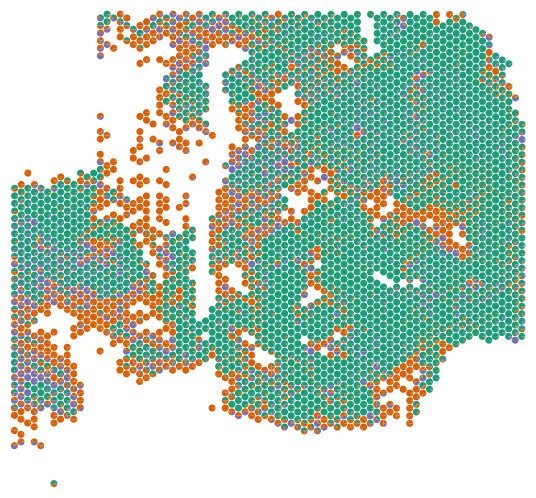

In [167]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

In [256]:
expr_deconv.T

,epithelial,macrophage,Bcell,Tcell,stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.005791,0.993152,0.000336,0.000175,0.000546
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.029744,0.267485,0.143631,0.000295,0.558845
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.993404,0.006150,0.000021,0.000006,0.000419
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.468435,0.000979,0.090283,0.137154,0.303149
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.999442,0.000284,0.000007,0.000187,0.000080
...,...,...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.999668,0.000099,0.000010,0.000021,0.000202
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.995689,0.000271,0.000001,0.000009,0.004030
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.668960,0.018757,0.000113,0.000113,0.312057
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.346218,0.000021,0.000006,0.000258,0.653498


In [251]:
vis_decon = expr_deconv.T

In [252]:
vis_decon['Immune'] = vis_decon['macrophage'] + vis_decon['Bcell'] + vis_decon['Tcell']
vis_decon.drop(columns=['macrophage', 'Bcell', 'Tcell'], inplace=True)
vis_decon = vis_decon[['epithelial', 'Immune', 'stroma']]

In [253]:
vis_decon.columns = ['Epithelial', 'Immune', 'Stroma']
vis_decon

,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.005791,0.993662,0.000546
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.029744,0.411411,0.558845
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.993404,0.006176,0.000419
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.468435,0.228416,0.303149
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.999442,0.000477,0.000080
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.999668,0.000130,0.000202
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.995689,0.000281,0.004030
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.668960,0.018983,0.312057
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.346218,0.000285,0.653498


In [254]:
raw_port - vis_decon

cell_type,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.994209,-0.993662,-0.000546
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.886923,-0.328078,-0.558845
TNBC_processed_adata_AACAGGATTCATAGTT-1,-0.076738,0.077157,-0.000419
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.300796,0.002353,-0.303149
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.000558,-0.000477,-0.000080
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.000332,-0.000130,-0.000202
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.004311,-0.000281,-0.004030
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.124144,-0.018983,-0.105161
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.653782,-0.000285,-0.653498


In [257]:
np.sqrt(((raw_port - vis_decon) ** 2).mean().mean())

0.2894775394822785

In [259]:
stats.pearsonr(raw_port['Epithelial'], vis_decon['Epithelial'])

PearsonRResult(statistic=0.5638866807359006, pvalue=4.320919117884059e-260)

In [260]:
stats.spearmanr(raw_port['Epithelial'], vis_decon['Epithelial'])

SignificanceResult(statistic=0.36144890052580775, pvalue=1.957321263137733e-96)

In [261]:
stats.pearsonr(raw_port['Immune'], vis_decon['Immune'])

PearsonRResult(statistic=0.6647031643508021, pvalue=0.0)

In [262]:
stats.spearmanr(raw_port['Immune'], vis_decon['Immune'])

SignificanceResult(statistic=0.5445676868752646, pvalue=2.982975316950561e-239)

In [263]:
stats.pearsonr(raw_port['Stroma'], vis_decon['Stroma'])

PearsonRResult(statistic=-0.04926413770383071, pvalue=0.006046637973411095)

In [264]:
stats.spearmanr(raw_port['Stroma'], vis_decon['Stroma'])

SignificanceResult(statistic=-0.055446057472545565, pvalue=0.0020000163225944276)

#### img

In [265]:
sc_ad_emb = anndata.AnnData(sc_text_features.T)
sc_ad_emb.obs = sc_data.obs.copy()
sc_ad_emb

AnnData object with n_obs × n_vars = 1062 × 768
    obs: 'cell_type', 'n_genes'

In [266]:
image_feature_path = os.path.join(data_path, sample_name+'_img_features'+case_name+'.csv')
image_features = pd.read_csv(image_feature_path, index_col=0)[ad_expr.obs.index]

In [267]:
img_ad = anndata.AnnData(image_features[ad_expr.obs.index].T)
img_ad.obs['cell_num']=ad_expr.obs['cell_num'].copy()
img_ad.uns['spatial']=ad_expr.uns['spatial'].copy()
img_ad.obsm['spatial']=ad_expr.obsm['spatial'].copy()
img_ad

AnnData object with n_obs × n_vars = 3104 × 768
    obs: 'cell_num'
    uns: 'spatial'
    obsm: 'spatial'

In [268]:
tg.pp_adatas(sc_ad_emb, img_ad, genes=None)

INFO:root:764 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:764 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [269]:
ad_map = tg.map_cells_to_space(sc_ad_emb, img_ad, 
    mode="clusters",
    # mode="constrained",
    cluster_label='cell_type',
    # device='cuda', 
    device='cpu', 
    scale=False,
    target_count=txt_ad.obs['cell_num'].sum(),
    density_prior=torch.from_numpy(density_prior),
)

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 764 genes and tensor([1.9623e-05, 2.3547e-04, 4.7095e-04,  ..., 5.6906e-04, 1.7661e-04,
        9.8114e-05], dtype=torch.float64) density_prior in clusters mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.010, KL reg: 0.493
Score: 0.076, KL reg: 0.003
Score: 0.079, KL reg: 0.003
Score: 0.080, KL reg: 0.003
Score: 0.081, KL reg: 0.003
Score: 0.081, KL reg: 0.003
Score: 0.081, KL reg: 0.003
Score: 0.081, KL reg: 0.003
Score: 0.081, KL reg: 0.003
Score: 0.081, KL reg: 0.003


INFO:root:Saving results..


In [270]:
tg.project_cell_annotations(ad_map, img_ad, annotation='cell_type')

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


In [271]:
for cell_type in img_ad.obsm['tangram_ct_pred'].columns:
    img_ad.obsm['tangram_ct_pred'][cell_type]=img_ad.obsm['tangram_ct_pred'][cell_type]*sc_ad_emb.obs['cell_type'].value_counts()[cell_type]

In [272]:
img_ad.obsm['tangram_ct_pred'] = img_ad.obsm['tangram_ct_pred'][['epithelial', 'macrophage', 'Bcell', 'Tcell', 'stroma']]
expr_deconv = img_ad.obsm['tangram_ct_pred'].T/img_ad.obsm['tangram_ct_pred'].T.sum()
expr_deconv

,TNBC_processed_adata_AACACGTGCATCGCAC-1,TNBC_processed_adata_AACACTTGGCAAGGAA-1,TNBC_processed_adata_AACAGGATTCATAGTT-1,TNBC_processed_adata_AACAGGTTATTGCACC-1,TNBC_processed_adata_AACAGGTTCACCGAAG-1,TNBC_processed_adata_AACAGTCGTGTCGCGG-1,TNBC_processed_adata_AACATATTCTTGCGAA-1,TNBC_processed_adata_AACATCGCGTGACCAC-1,TNBC_processed_adata_AACATCTAATGACCGG-1,TNBC_processed_adata_AACATGACTTGGCTGC-1,...,TNBC_processed_adata_TGTTCACTCACGGTAA-1,TNBC_processed_adata_TGTTCAGAACGGTGTA-1,TNBC_processed_adata_TGTTCCTCACATTAAT-1,TNBC_processed_adata_TGTTCTGCTCTGTCGT-1,TNBC_processed_adata_TGTTGCGTCCAAGATT-1,TNBC_processed_adata_TGTTGGAACCTTCCGC-1,TNBC_processed_adata_TGTTGGAACGAGGTCA-1,TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,TNBC_processed_adata_TGTTGGATGGACTTCT-1,TNBC_processed_adata_TGTTGGCCTACACGTG-1
epithelial,0.012634,0.507128,0.949972,0.022052,0.999649,0.086184,0.740355,0.007659,0.555624,0.173017,...,0.999621,0.139649,0.008905,0.999221,0.846153,0.999821,0.999950,0.999762,0.063153,0.004084
macrophage,0.987164,0.000024,0.049804,0.111512,0.000162,0.000910,0.000134,0.001267,0.000013,0.511255,...,0.000184,0.860234,0.000122,0.000636,0.000187,0.000086,0.000025,0.000216,0.017072,0.000167
Bcell,0.000017,0.000006,0.000126,0.000019,0.000005,0.117942,0.000008,0.363046,0.000003,0.000023,...,0.000006,0.000003,0.990184,0.000003,0.000006,0.000004,0.000004,0.000005,0.000003,0.473281
Tcell,0.000055,0.341042,0.000067,0.000182,0.000073,0.006332,0.003332,0.627252,0.000010,0.000023,...,0.000045,0.000020,0.000213,0.000116,0.000006,0.000029,0.000012,0.000010,0.154698,0.000234
stroma,0.000129,0.151801,0.000032,0.866234,0.000109,0.788632,0.256171,0.000776,0.444350,0.315681,...,0.000145,0.000093,0.000576,0.000024,0.153648,0.000059,0.000009,0.000007,0.765073,0.522234


In [273]:
data = np.array(expr_deconv.T)
coordinates = np.array([img_ad.obsm['spatial'][:, 0], -img_ad.obsm['spatial'][:, 1]]).T/img_ad.obsm['spatial'].max()

100%|██████████| 3104/3104 [01:01<00:00, 50.44it/s]


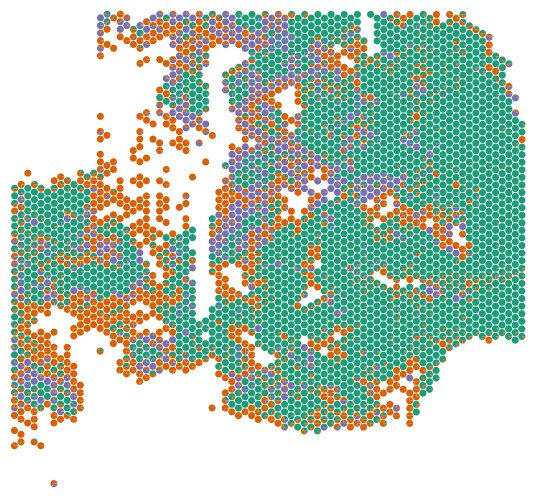

In [177]:
colors = cmap([0, 1, 1, 1, 2])
plt_pie_chart(data, coordinates, colors)

In [274]:
expr_deconv.T

,epithelial,macrophage,Bcell,Tcell,stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.012634,0.987164,0.000017,0.000055,0.000129
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.507128,0.000024,0.000006,0.341042,0.151801
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.949972,0.049804,0.000126,0.000067,0.000032
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.022052,0.111512,0.000019,0.000182,0.866234
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.999649,0.000162,0.000005,0.000073,0.000109
...,...,...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.999821,0.000086,0.000004,0.000029,0.000059
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.999950,0.000025,0.000004,0.000012,0.000009
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.999762,0.000216,0.000005,0.000010,0.000007
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.063153,0.017072,0.000003,0.154698,0.765073


In [275]:
vis_decon = expr_deconv.T

In [276]:
vis_decon['Immune'] = vis_decon['macrophage'] + vis_decon['Bcell'] + vis_decon['Tcell']
vis_decon.drop(columns=['macrophage', 'Bcell', 'Tcell'], inplace=True)
vis_decon = vis_decon[['epithelial', 'Immune', 'stroma']]

In [277]:
vis_decon.columns = ['Epithelial', 'Immune', 'Stroma']
vis_decon

,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.012634,0.987236,0.000129
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.507128,0.341071,0.151801
TNBC_processed_adata_AACAGGATTCATAGTT-1,0.949972,0.049996,0.000032
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.022052,0.111713,0.866234
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.999649,0.000241,0.000109
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.999821,0.000119,0.000059
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.999950,0.000041,0.000009
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,0.999762,0.000231,0.000007
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.063153,0.171773,0.765073


In [278]:
raw_port - vis_decon

cell_type,Epithelial,Immune,Stroma
TNBC_processed_adata_AACACGTGCATCGCAC-1,0.987366,-0.987236,-0.000129
TNBC_processed_adata_AACACTTGGCAAGGAA-1,0.409539,-0.257738,-0.151801
TNBC_processed_adata_AACAGGATTCATAGTT-1,-0.033305,0.033337,-0.000032
TNBC_processed_adata_AACAGGTTATTGCACC-1,0.747178,0.119056,-0.866234
TNBC_processed_adata_AACAGGTTCACCGAAG-1,0.000351,-0.000241,-0.000109
...,...,...,...
TNBC_processed_adata_TGTTGGAACCTTCCGC-1,0.000179,-0.000119,-0.000059
TNBC_processed_adata_TGTTGGAACGAGGTCA-1,0.000050,-0.000041,-0.000009
TNBC_processed_adata_TGTTGGAAGCTCGGTA-1,-0.206658,-0.000231,0.206890
TNBC_processed_adata_TGTTGGATGGACTTCT-1,0.936847,-0.171773,-0.765073


In [286]:
np.sqrt(((raw_port - vis_decon) ** 2).mean().mean())

0.34730413129619825

In [293]:
((raw_port - vis_decon) ** 2).mean(axis=0)

cell_type
Epithelial    0.173020
Immune        0.094799
Stroma        0.094041
dtype: float64

In [280]:
stats.pearsonr(raw_port['Epithelial'], vis_decon['Epithelial'])

PearsonRResult(statistic=0.4987551227956081, pvalue=6.216253923865434e-195)

In [281]:
stats.spearmanr(raw_port['Epithelial'], vis_decon['Epithelial'])

SignificanceResult(statistic=0.3247140265110328, pvalue=3.893164753134875e-77)

In [282]:
stats.pearsonr(raw_port['Immune'], vis_decon['Immune'])

PearsonRResult(statistic=0.6348341500164643, pvalue=0.0)

In [283]:
stats.spearmanr(raw_port['Immune'], vis_decon['Immune'])

SignificanceResult(statistic=0.500766712069036, pvalue=9.69550176200955e-197)

In [284]:
stats.pearsonr(raw_port['Stroma'], vis_decon['Stroma'])

PearsonRResult(statistic=-0.078781825482344, pvalue=1.1114128463305373e-05)

In [285]:
stats.spearmanr(raw_port['Stroma'], vis_decon['Stroma'])

SignificanceResult(statistic=-0.16537347850424466, pvalue=1.7970775421636215e-20)